This script generates the plots for the figures in the supplementary material using `.pkl` files containing the selected simulation outputs created by the **data_saving.py** and other **IDL** scripts.

In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

Importing libraries

In [2]:
import pandas as pd
from matplotlib import pyplot as plt
import matplotlib as mlt
import numpy as np
from matplotlib.ticker import MultipleLocator,LogLocator, FixedLocator
from matplotlib.ticker import ScalarFormatter,NullFormatter
from matplotlib import gridspec
plt.rcParams.update({'font.size': 20})
plt.rcParams["font.weight"] = "normal"
plt.rcParams["axes.labelweight"] = "normal"
params = {'mathtext.default': 'regular' }
plt.rcParams['axes.linewidth'] = 3
y_formatter = ScalarFormatter()
from my_functions import S2, S3, S4, S5, s_transfer, S6, S7, lat_lon, marker_color
from sklearn.metrics import r2_score
from scipy.stats import linregress
import joblib as jb

Loading primary data

In [3]:
all_data = jb.load('../supp_data/selected_simulations_time_short.pkl')
main_headers = all_data.keys()
#for header in main_headers:
#    print(header)

<span style="font-size:40px;">Figure S1</span>

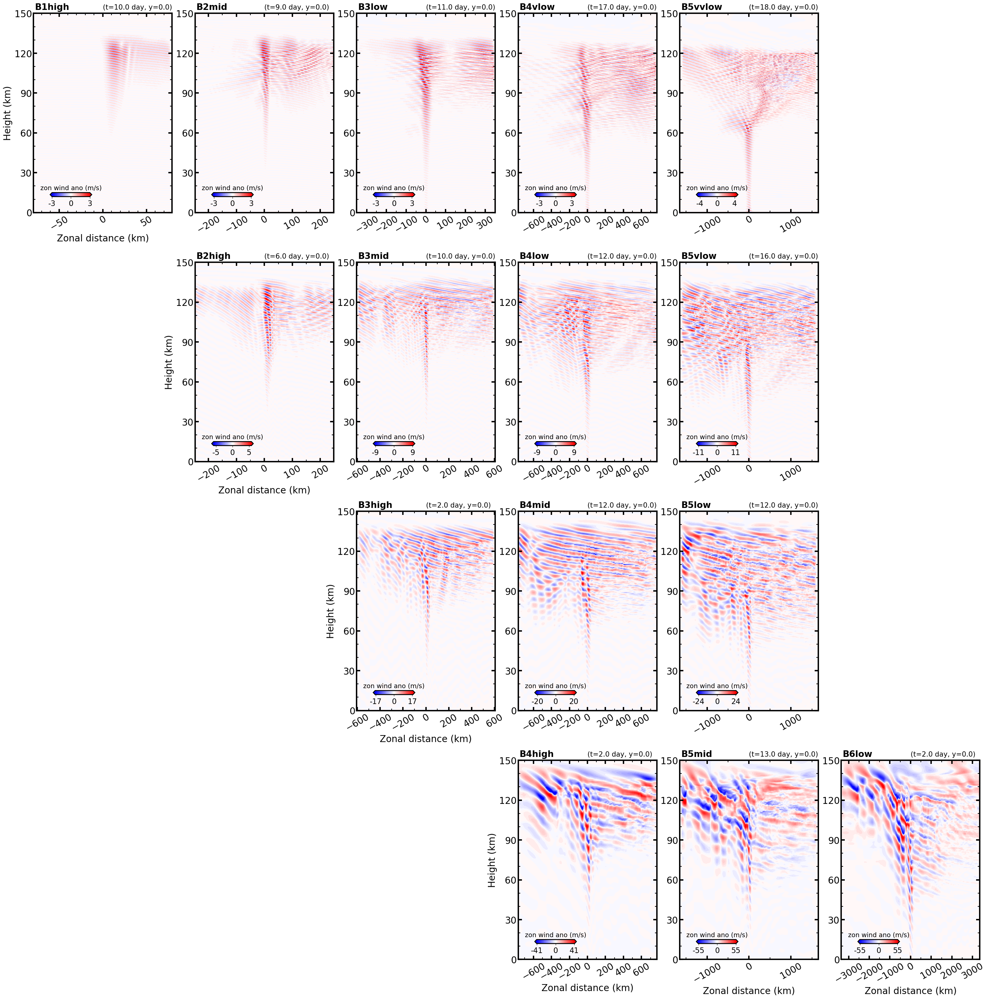

In [4]:
fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(30, 30))
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
fig.tight_layout(pad=2.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.25)

for iname in (main_headers):
    
#    print(iname)
    data = all_data[iname]
    lon = data['lon']
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)']
    m_u = data['m_u(t,z)']
      
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1])-1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    ax = axes[j, i]
    ax.axis("on")  # Activate the frame
    lim=None
    if j==0 and i==0: lim=3
    S2(lon, time, height, u0, m_u, fig, ax, iname,lim=lim)

    # Set labels based on row and column positions
    if i == j:        
        ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
    elif j == 3:
        ax.set(xlabel='Zonal distance (km)')

# plt.savefig('../supp_figs/FigS1.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS1.png', bbox_inches='tight', dpi=90)  
plt.show()   

<span style="font-size:40px;">Figure S2</span>

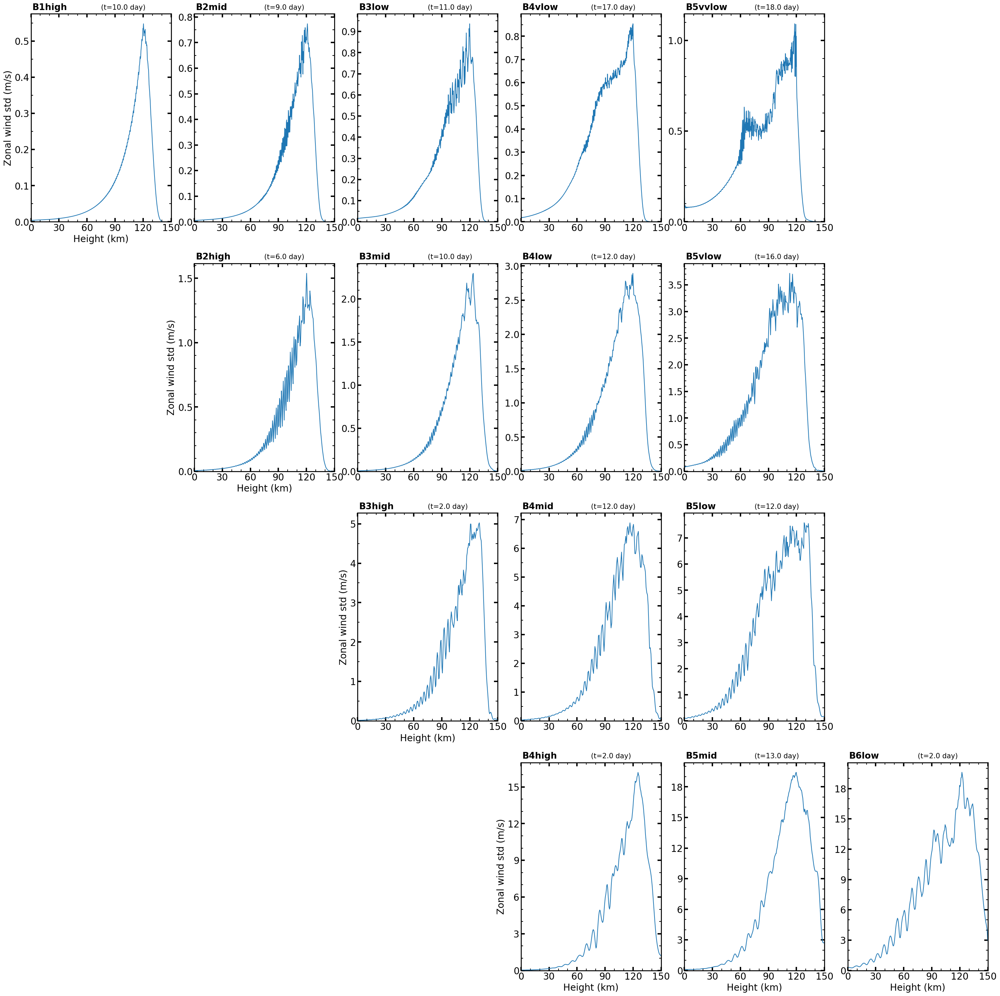

In [5]:
fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(30, 30))
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
fig.tight_layout(pad=2.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)

for iname in (main_headers):
    
#    print(iname)
    data = all_data[iname]
    time = data['time']
    height = data['height'][:,1]
    std_u = data['std_up(z)']
    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1])-1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    ax = axes[j, i]
    ax.axis("on")  # Activate the frame
    S3(time,height,std_u.data,ax,iname)

    # Set labels based on row and column positions
    if i == j:        
        ax.set(ylabel='Zonal wind std (m/s)', xlabel='Height (km)')
    elif j == 3:
        ax.set(xlabel='Height (km)')
    

# plt.savefig('../supp_figs/FigS2.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS2.png', bbox_inches='tight')  
plt.show()   

<span style="font-size:40px;">Figure S3</span>

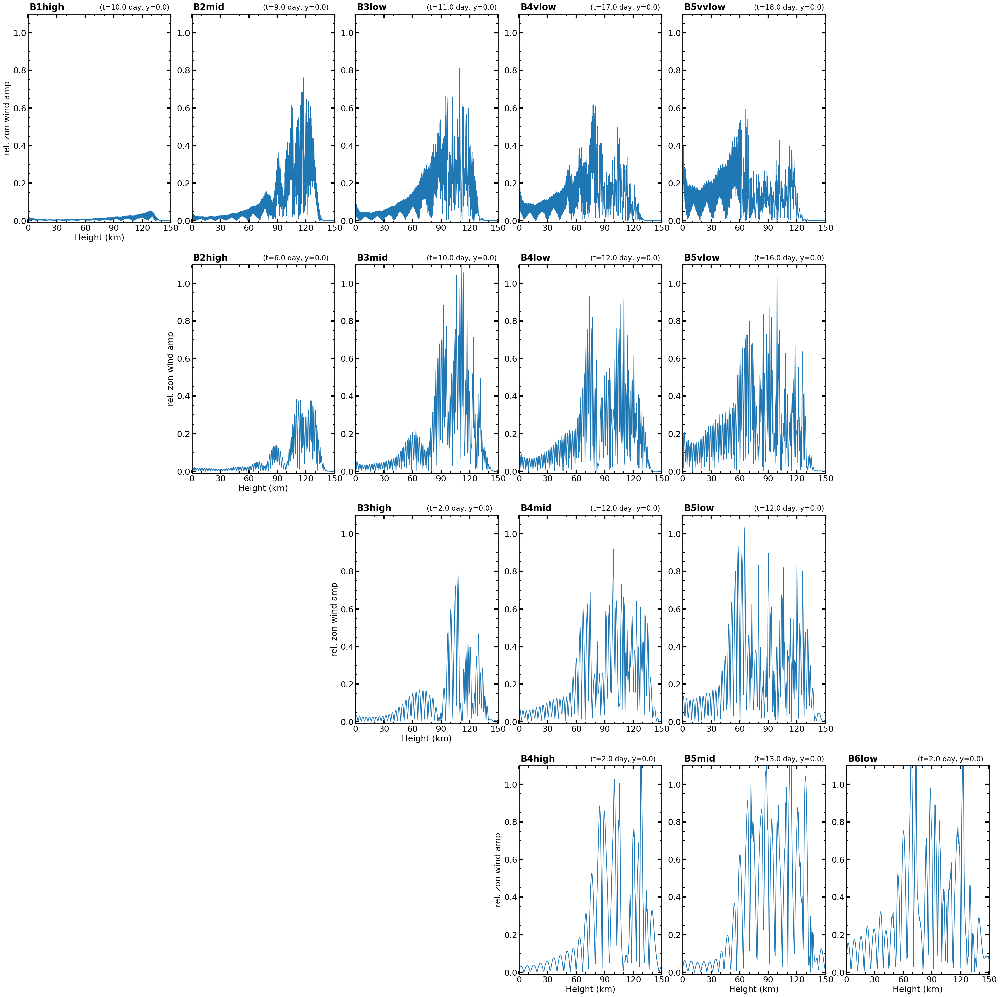

In [6]:
fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(30, 30))
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
fig.tight_layout(pad=2.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)

for iname in (main_headers):
    
#    print(iname)
    data = all_data[iname]
    lon_m = int(len(data['lon'])/2)+1
    time = data['time']
    height = data['height'][:,1]
    m_u = data['m_u(t,z)']
    u0 = data['u(t,z,0,lon)'][:,lon_m]
    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1])-1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    ax = axes[j, i]
    ax.axis("on")  # Activate the frame
    S4(lon, time, height, u0, m_u, ax, iname)

    # Set labels based on row and column positions
    if i == j:        
        ax.set(ylabel='rel. zon wind amp', xlabel='Height (km)')
    elif j == 3:
        ax.set(xlabel='Height (km)')


# plt.savefig('../supp_figs/FigS3.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS3.png', bbox_inches='tight')  
plt.show()   

<span style="font-size:40px;">Figure S5</span>

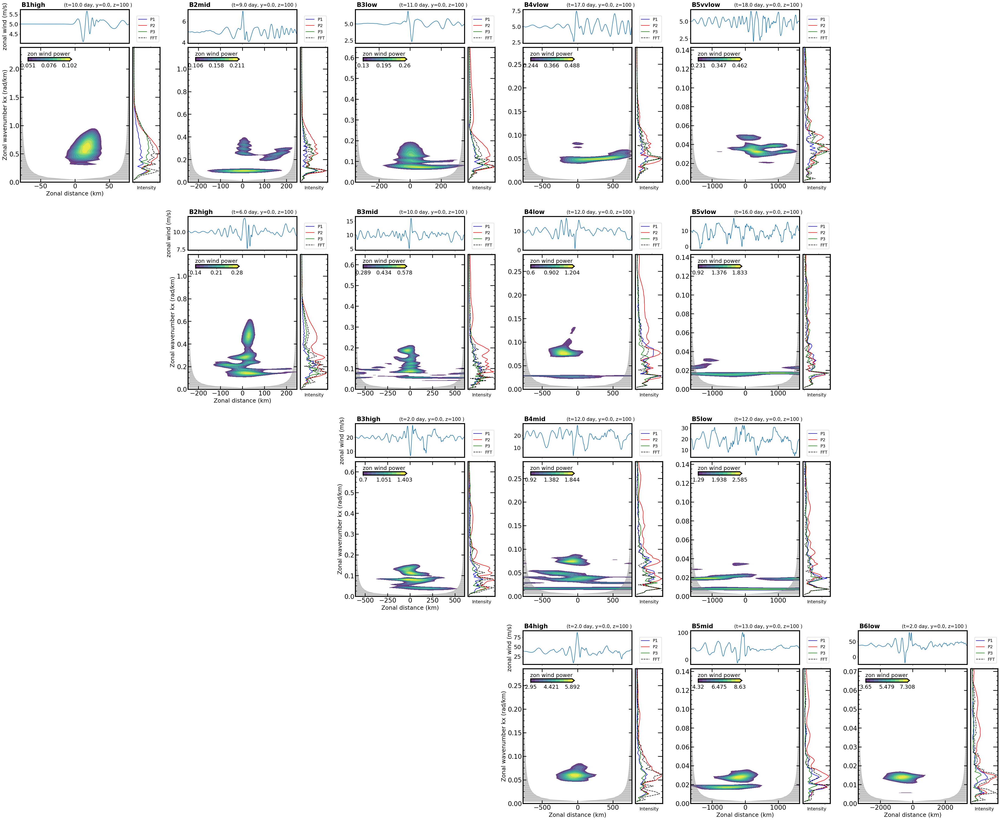

In [7]:
rows, cols = 4, 6
fig = plt.figure(figsize=(55, 45))  # Adjust aspect ratio

fig.tight_layout(pad=2.5)  # Use tight_layout to handle spacing automatically

for iname in (main_headers):
    data = all_data[iname]
    lon = data['lon']
    time = data['time']
    height = data['height'][:, 1]
    u0 = data['u(t,z,0,lon)']
    index100 = np.argmin(np.abs(height - 100.0))
    uu = u0[index100, :]
    dx = abs(lon[0] - lon[1]) * 110

    power, spectrum, freq = s_transfer(uu, dx)
    powerd = power[0:len(freq), :]  
    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1]) - 1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    spec = gridspec.GridSpecFromSubplotSpec(
        nrows=2, ncols=2,
        subplot_spec=plt.GridSpec(rows, cols)[j, i],
        width_ratios=[4, 1], height_ratios=[1, 4],
        wspace=0.05, hspace=0.05
    )
   
    axs, axu = S6(fig, spec, lon, time, 100, uu, powerd, spectrum, freq, iname)

    if i == j:        
        axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
        axu.set_ylabel('zonal wind (m/s)')
    elif j == 3:
        axs.set(xlabel='Zonal distance (km)')

# plt.savefig('../supp_figs/FigS5.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS5.png', bbox_inches='tight', dpi=70)  
plt.show()   

<span style="font-size:40px;">Figure S6</span>

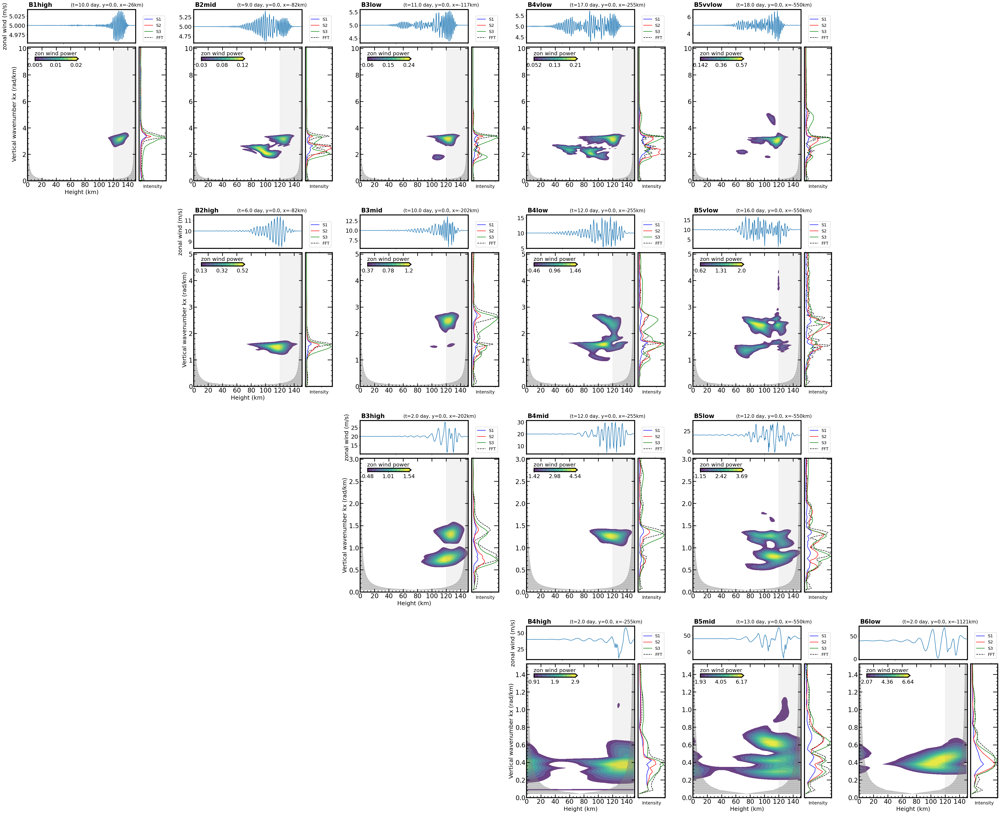

In [8]:
rows, cols = 4, 6
fig = plt.figure(figsize=(55, 45))  # Adjust aspect ratio

fig.tight_layout(pad=2.5)  # Use tight_layout to handle spacing automatically

for iname in (main_headers):
    data = all_data[iname]
    lon = data['lon']
    time = data['time']
    height = data['height'][:, 1]
    u0 = data['u(t,z,0,lon)']
    index_l = int(len(lon)/3) # upwind
    uu = u0[:, index_l]
    dz = abs(height[0] - height[1]) 

    power, spectrum, freq = s_transfer(uu, dz)
    powerd = power[0:len(freq), :]  
    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1]) - 1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    spec = gridspec.GridSpecFromSubplotSpec(
        nrows=2, ncols=2,
        subplot_spec=plt.GridSpec(rows, cols)[j, i],
        width_ratios=[4, 1], height_ratios=[1, 4],
        wspace=0.05, hspace=0.05
    )

    x = int(lon[index_l]*110)# zonal distance (km)
    # print(iname,len(height),len(uu))
    axs, axu = S7(fig, spec, height, time, x, uu, powerd, spectrum, freq, iname)

    if i == j:        
        axs.set(xlabel='Height (km)', ylabel='Vertical wavenumber kx (rad/km)')
        axu.set_ylabel('zonal wind (m/s)')
    elif j == 3:
        axs.set(xlabel='Height (km)')


# plt.savefig('../supp_figs/FigS6.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS6.png', bbox_inches='tight', dpi=70)  
plt.show()   

<span style="font-size:40px;">Figure S7</span>

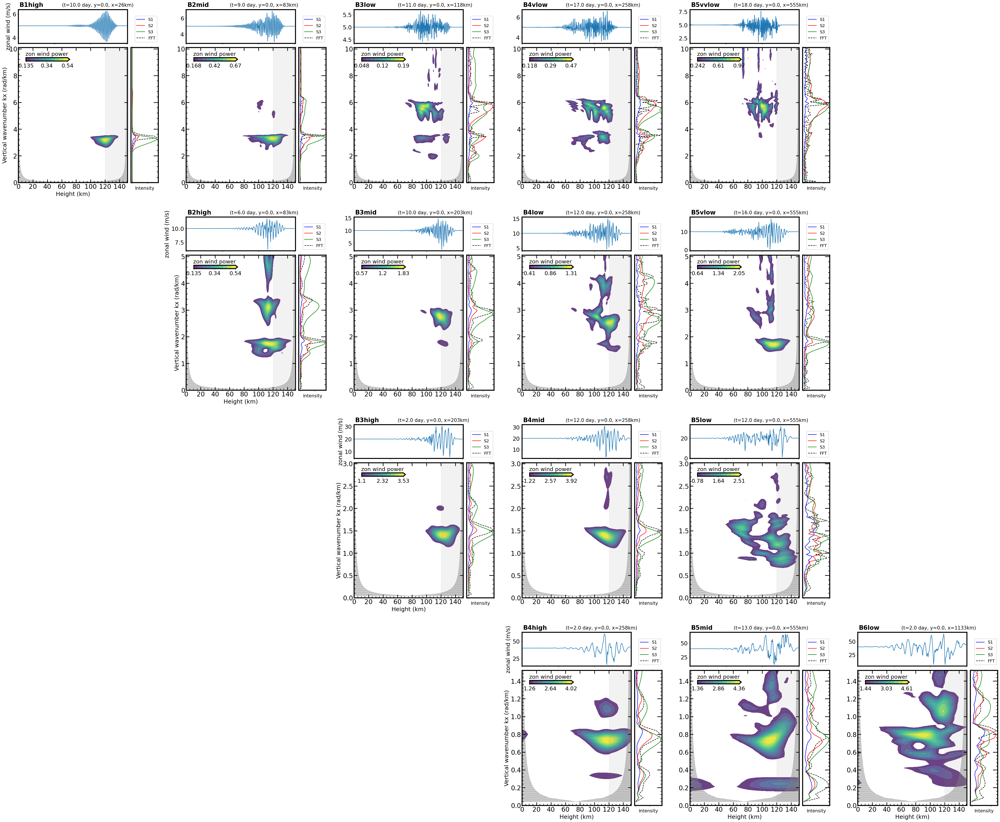

In [9]:
rows, cols = 4, 6
fig = plt.figure(figsize=(55, 45))  # Adjust aspect ratio

fig.tight_layout(pad=2.5)  # Use tight_layout to handle spacing automatically

for iname in (main_headers):
    data = all_data[iname]
    lon = data['lon']
    time = data['time']
    height = data['height'][:, 1]
    u0 = data['u(t,z,0,lon)']
    index_l = -int(len(lon)/3) # downwind
    uu = u0[:, index_l]
    dz = abs(height[0] - height[1]) 

    power, spectrum, freq = s_transfer(uu, dz)
    powerd = power[0:len(freq), :]  
    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1]) - 1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    spec = gridspec.GridSpecFromSubplotSpec(
        nrows=2, ncols=2,
        subplot_spec=plt.GridSpec(rows, cols)[j, i],
        width_ratios=[4, 1], height_ratios=[1, 4],
        wspace=0.05, hspace=0.05
    )

    x = int(lon[index_l]*110)# zonal distance (km)
    # print(iname,len(height),len(uu))
    axs, axu = S7(fig, spec, height, time, x, uu, powerd, spectrum, freq, iname)

    if i == j:        
        axs.set(xlabel='Height (km)', ylabel='Vertical wavenumber kx (rad/km)')
        axu.set_ylabel('zonal wind (m/s)')
    elif j == 3:
        axs.set(xlabel='Height (km)')


# plt.savefig('../supp_figs/FigS7.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS7.png', bbox_inches='tight', dpi=70)  
plt.show()   

<span style="font-size:40px;">Figure S8</span>

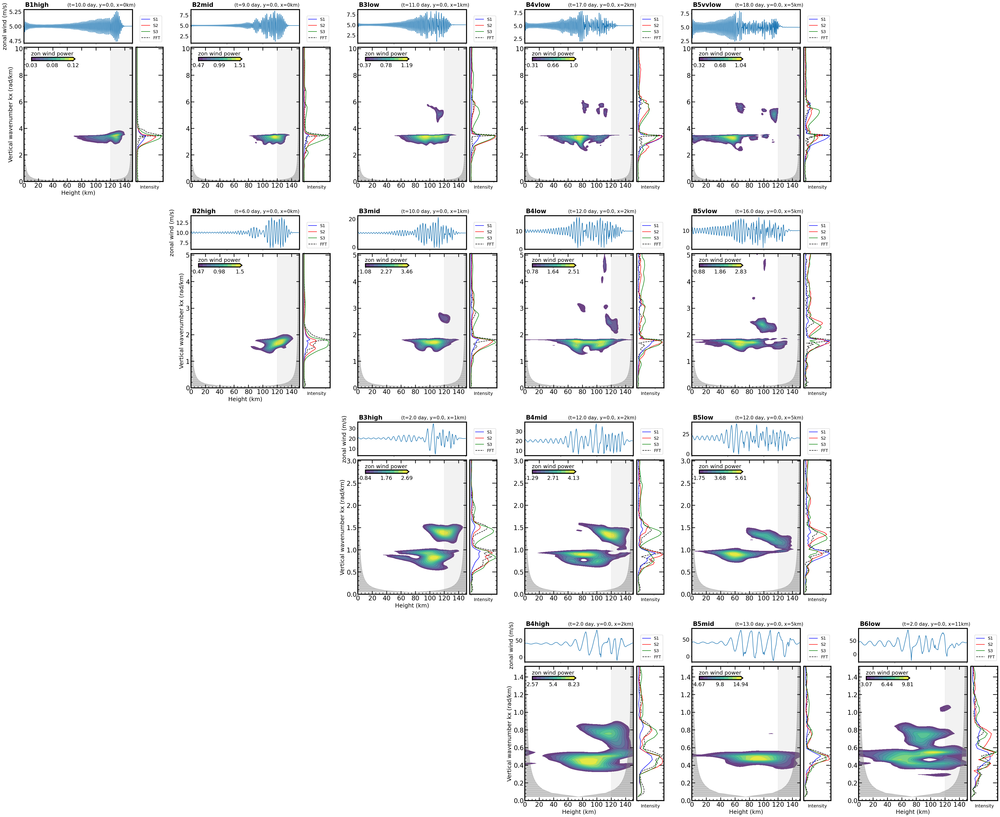

In [10]:
rows, cols = 4, 6
fig = plt.figure(figsize=(55, 45))  # Adjust aspect ratio

fig.tight_layout(pad=2.5)  # Use tight_layout to handle spacing automatically

for iname in (main_headers):
    data = all_data[iname]
    lon = data['lon']
    time = data['time']
    height = data['height'][:, 1]
    u0 = data['u(t,z,0,lon)']
    index_l = int(len(lon)/2)+1 # perpendicular to the mountain crest
    uu = u0[:, index_l]
    dz = abs(height[0] - height[1]) 

    power, spectrum, freq = s_transfer(uu, dz)
    powerd = power[0:len(freq), :]  
    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1]) - 1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    spec = gridspec.GridSpecFromSubplotSpec(
        nrows=2, ncols=2,
        subplot_spec=plt.GridSpec(rows, cols)[j, i],
        width_ratios=[4, 1], height_ratios=[1, 4],
        wspace=0.05, hspace=0.05
    )

    x = int(lon[index_l]*110)# zonal distance (km)
    # print(iname,len(height),len(uu))
    axs, axu = S7(fig, spec, height, time, x, uu, powerd, spectrum, freq, iname)

    if i == j:        
        axs.set(xlabel='Height (km)', ylabel='Vertical wavenumber kx (rad/km)')
        axu.set_ylabel('zonal wind (m/s)')
    elif j == 3:
        axs.set(xlabel='Height (km)')


# plt.savefig('../supp_figs/FigS8.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS8.png', bbox_inches='tight', dpi=70) 
plt.show()

<span style="font-size:40px;">Figure S4</span>

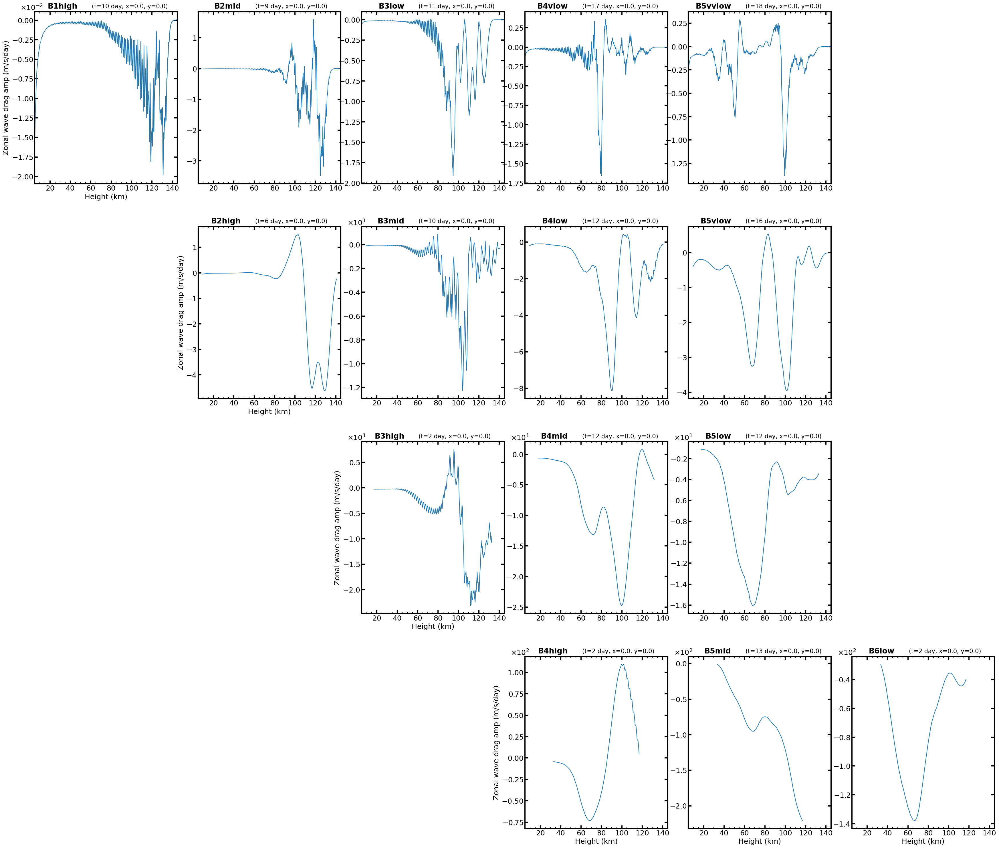

In [11]:
all_data5 = jb.load('../supp_data/FigS4.pkl')
main_headers = all_data5.keys()


fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(35, 30))
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
fig.tight_layout(pad=2.9)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.25)

for iname in (main_headers):
    data = all_data5[iname]
    time = data['time']
    height = data['height']
    a_x = data['a_x']

    
    tnames = iname[:2]
    tstrength = iname[2:]
    icol = int(iname[1])-1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    ax = axes[j, i]
    ax.axis("on")  # Activate the frame

    S5(time, height, a_x, ax, iname)
    # Set labels based on row and column positions
    if i == j:        
        ax.set(ylabel='Zonal wave drag amp (m/s/day)', xlabel='Height (km)')
    elif j == 3:
        ax.set(xlabel='Height (km)')

# plt.savefig('../supp_figs/FigS4.pdf', bbox_inches='tight')
# plt.savefig('../supp_figs/FigS4.png', bbox_inches='tight', dpi=70) 
plt.show()

<span style="font-size:40px;">Figure S9</span>

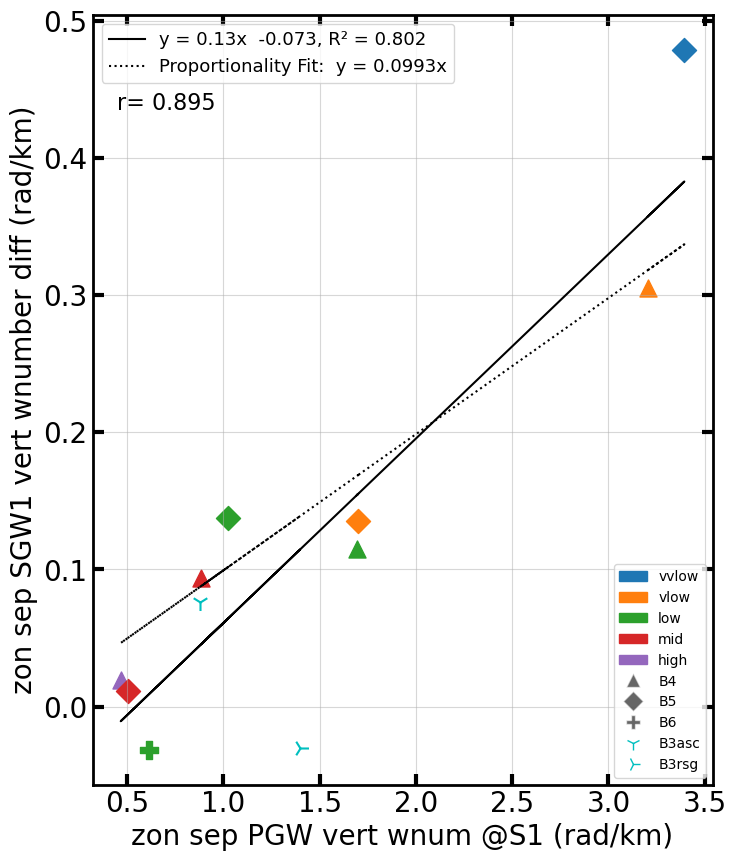

In [12]:
df = jb.load('../supp_data/FigS9.pkl')
fdf, tnames, tstrength, legend_elements = marker_color(df)


# mask = ['B4high','B3high','B4mid','B4low','B5low','B5vlow','B2high','B3mid','B5vvlow']  # Apply mask to filter the DataFrame for the experiments with strong SGW1 (e(P1,P3)_2,1>0.3_e1)
# fdf = df.astype(str)[df['Test_name'].isin(mask)]
# # Convert 'x' and 'y' back to float after filtering
fdf['x'] = fdf['x'].astype(float); x = fdf['x']
fdf['y'] = fdf['y'].astype(float); y = fdf['y']
fdf = fdf.reset_index(drop=True)
fdf

fig, ax = plt.subplots(figsize=(8, 10))

ax.grid(True, alpha=0.5)
ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)
# Scatter plot with colors and markers
for i in range(len(fdf)):    
    ax.scatter(fdf.at[i, 'x'], fdf.at[i, 'y'], color=fdf.at[i, 'color'], s=150, marker=fdf.at[i, 'marker'])   

# Add grid and labels
ax.set_xlabel("zon sep PGW vert wnum @S1 (rad/km)")
ax.set_ylabel("zon sep SGW1 vert wnumber diff (rad/km)")

# Legend for scatter points
scatter_legend = ax.legend(handles=legend_elements, loc="lower right", fontsize=10)
ax.add_artist(scatter_legend)  # Add the scatter legend manually

# Perform Linear Regression (y = mx + c)
coeffs_linear = np.polyfit(x, y, 1)  # Degree 1 polynomial
y_linear = np.polyval(coeffs_linear, x)
r2_linear = r2_score(y, y_linear)

slope, intercept, r_value, p_value, std_err = linregress(x, y)
y_linreg = slope * x + intercept
p2 = ax.plot(x, y_linreg, '-k', label='Linear Regression')

# Perform Proportionality Fit (y = mx)
slope_proportional = np.sum(x * y) / np.sum(x**2)  # Least-squares slope with intercept = 0
y_proportional = slope_proportional * x
p3 = ax.plot(x, y_proportional, ':k', label='Proportionality Fit')

# Add additional legend for  p2, p3
additional_legend = ax.legend(handles=[
    plt.Line2D([0], [0], linestyle='-', color='k', label="y = {:.2f}x  {:.3f}, R² = {:.3f}".format(slope, intercept, r2_linear)),
    plt.Line2D([0], [0], linestyle=':', color='k', label='Proportionality Fit:  y = {:.4f}x'.format(slope_proportional))
], loc="upper left", fontsize=13)

ax.text(0.04, 0.90, "r= "+str(np.round(np.corrcoef(x, y)[0,1],3))
        , transform=ax.transAxes, fontsize=16,
        verticalalignment='top', horizontalalignment='left')

# plt.savefig('../supp_figs/FigS9.pdf',bbox_inches='tight')
plt.show()


<span style="font-size:40px;">Figure S10</span>

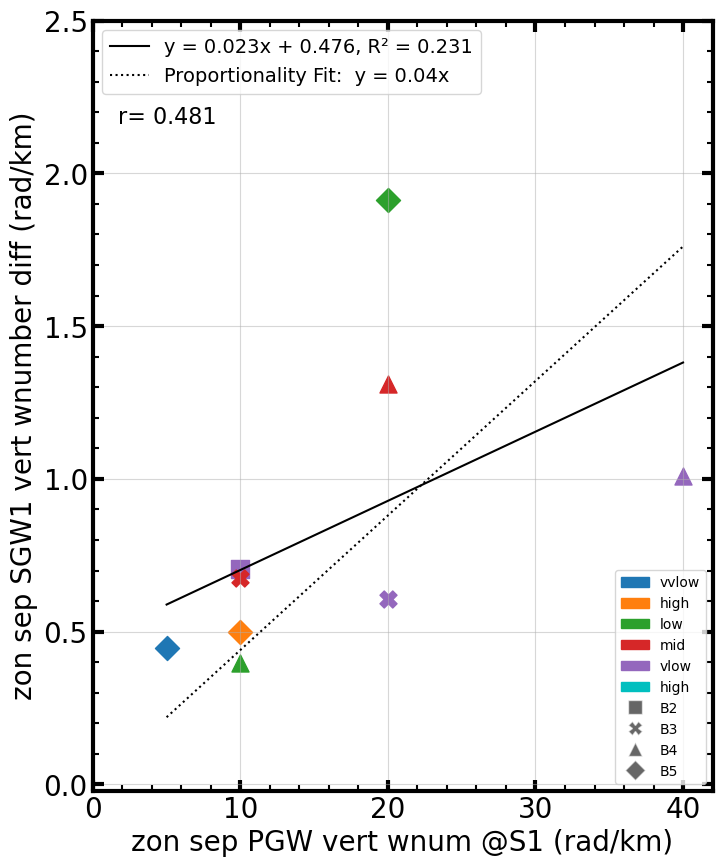

In [2]:
df = jb.load('../supp_data/FigS10.pkl')
fdf, tnames, tstrength, legend_elements = marker_color(df)

mask = ['B4high','B3high','B4mid','B4low','B5low','B5vlow','B2high','B3mid','B5vvlow']  # Apply mask to filter the DataFrame for the experiments with strong SGW1 (e(P1,P3)_2,1>0.3_e1)
fdf = df.astype(str)[df['Test_name'].isin(mask)]
# Convert 'x' and 'y' back to float after filtering
fdf['x'] = fdf['x'].astype(float); x = fdf['x']
fdf['y'] = fdf['y'].astype(float); y = fdf['y']
fdf = fdf.reset_index(drop=True)
fdf

fig, ax = plt.subplots(figsize=(8, 10))

ax.grid(True, alpha=0.5)
ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)
# Scatter plot with colors and markers
for i in range(len(fdf)):    
    ax.scatter(fdf.at[i, 'x'], fdf.at[i, 'y'], color=fdf.at[i, 'color'], s=150, marker=fdf.at[i, 'marker'])   

# Add grid and labels
ax.set_xlabel("zon sep PGW vert wnum @S1 (rad/km)")
ax.set_ylabel("zon sep SGW1 vert wnumber diff (rad/km)")

# Set axis limits
ax.set_xlim([-0.02, 42])
ax.set_ylim([-0.02, 2.5])
ax.yaxis.set_major_locator(MultipleLocator(0.5))
ax.yaxis.set_minor_locator(MultipleLocator(0.1))
ax.xaxis.set_major_locator(MultipleLocator(10))
ax.xaxis.set_minor_locator(MultipleLocator(2))

# Legend for scatter points
scatter_legend = ax.legend(handles=legend_elements, loc="lower right", fontsize=10)
ax.add_artist(scatter_legend)  # Add the scatter legend manually

# Perform Linear Regression (y = mx + c)
coeffs_linear = np.polyfit(x, y, 1)  # Degree 1 polynomial
y_linear = np.polyval(coeffs_linear, x)
r2_linear = r2_score(y, y_linear)
# ax.plot(xx, y_linear, '-k', label=f"Linear Fit (R²={r2_linear:.2f})")

slope, intercept, r_value, p_value, std_err = linregress(x, y)
y_linreg = slope * x + intercept
p2 = ax.plot(x, y_linreg, '-k', label='Linear Regression')

# Perform Proportionality Fit (y = mx)
slope_proportional = np.sum(x * y) / np.sum(x**2)  # Least-squares slope with intercept = 0
y_proportional = slope_proportional * x
p3 = ax.plot(x, y_proportional, ':k', label='Proportionality Fit')

# Add additional legend for p1, p2, p3
additional_legend = ax.legend(handles=[
    plt.Line2D([0], [0], linestyle='-', color='k', label="y = {:.3f}x + {:.3f}, R² = {:.3f}".format(slope, intercept, r2_linear)),
    plt.Line2D([0], [0], linestyle=':', color='k', label='Proportionality Fit:  y = {:.2f}x'.format(slope_proportional))
], loc="upper left", fontsize=14)

ax.text(0.2, 0.89, "r= "+str(np.round(np.corrcoef(x, y)[0,1],3))
        , transform=ax.transAxes, fontsize=16,
        verticalalignment='top', horizontalalignment='right')

# plt.savefig('../supp_figs/FigS10.pdf',bbox_inches='tight')
plt.show()


<span style="font-size:40px;">Figure S11</span>

height
length


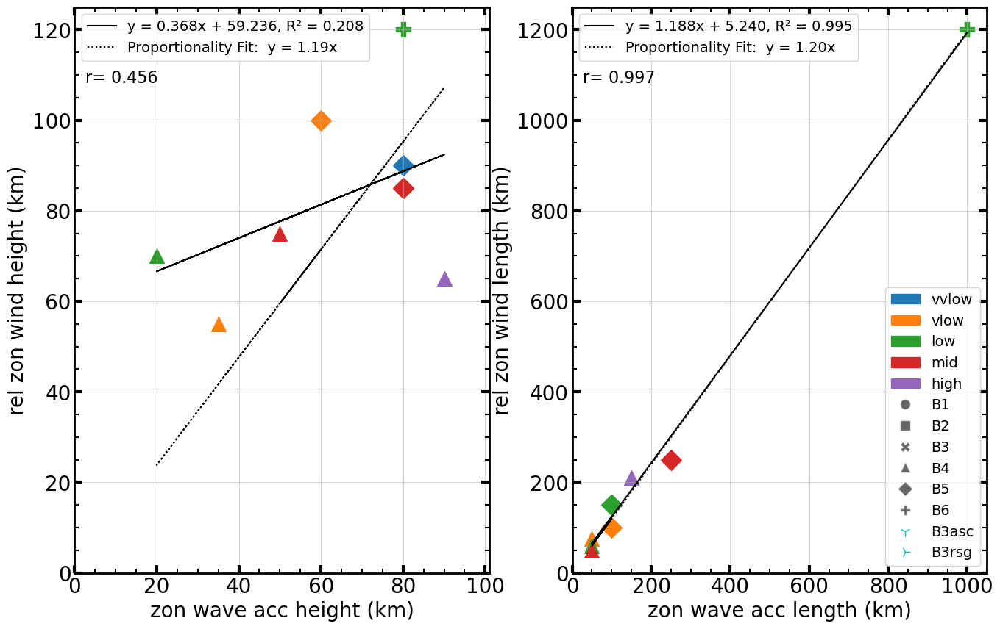

In [13]:
Table = jb.load('../supp_data/FigS11.pkl')
headers = Table.keys()

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 10))

l = 0
for h in headers:
    print(h)
    ############# defining the subplot WRT the data to plot mentioned as the deaders in the dictionary ###
    j = 1 if h[0] == 'l' else 0 # j=1 for length and j=0 for height 
    ax = axes[j]
    
    ax.grid(True, alpha=0.5)
    ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
    ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)
    ############## reading data###########################################################################
    df = Table[h]
    df, _, _, legend_elements = marker_color(df)
    
    mask = ['B4high','B4mid','B4low','B4vlow','B5mid','B5low','B5vlow','B5vvlow','B6low']  # Apply mask to filter the DataFrame for the experiments with strong SGW1 (e(P1,P3)_2,1>0.3_e1)
    fdf = df.astype(str)[df['Test_name'].isin(mask)]
    # Convert 'x' and 'y' back to float after filtering
    fdf['x'] = fdf['x'].astype(float); x = fdf['x']
    fdf['y'] = fdf['y'].astype(float); y = fdf['y']
    fdf = fdf.reset_index(drop=True)
    ######################################################################################################
    # Scatter plot with colors and markers
    for k in range(len(fdf)): 
        ax.scatter(fdf.at[k, 'x'], fdf.at[k, 'y'], color=fdf.at[k, 'color'], s=200, marker=fdf.at[k, 'marker'])   
    ######################################################################################################
    if j ==0:
        ax.set_xlabel("zon wave acc height (km)")
        ax.set_ylabel("rel zon wind height (km)")
        ax.set_xlim([0, 101]); x_major = 20; x_minor = 5
        ax.set_ylim([0, 125]); y_major = 20; y_minor = 5
    if j==1:        
        ax.set_xlabel("zon wave acc length (km)")
        ax.set_ylabel("rel zon wind length (km)"); 
        ax.set_xlim([0, 1050]); x_major = 200; x_minor = 50
        ax.set_ylim([0, 1250]); y_major = 200; y_minor = 50
        scatter_legend = ax.legend(handles=legend_elements, loc="lower right", fontsize=14)
        ax.add_artist(scatter_legend)  # Add the scatter legend manually
    
    ax.yaxis.set_major_locator(MultipleLocator(y_major))
    ax.yaxis.set_minor_locator(MultipleLocator(y_minor))
    ax.xaxis.set_major_locator(MultipleLocator(x_major))
    ax.xaxis.set_minor_locator(MultipleLocator(x_minor))    
    ######################################################################################################
    # Perform Linear Regression (y = mx + c)
    coeffs_linear = np.polyfit(x, y, 1)  # Degree 1 polynomial
    y_linear = np.polyval(coeffs_linear, x)
    r2_linear = r2_score(y, y_linear)
    
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    y_linreg = slope * x + intercept
    p2 = ax.plot(x, y_linreg, '-k', label='Linear Regression')
    
    # Perform Proportionality Fit (y = mx)
    slope_proportional = np.sum(x * y) / np.sum(x**2)  # Least-squares slope with intercept = 0
    y_proportional = slope_proportional * x
    p3 = ax.plot(x, y_proportional, ':k', label='Proportionality Fit')
    
    # Add additional legend for p1, p2, p3
    additional_legend = ax.legend(handles=[
        plt.Line2D([0], [0], linestyle='-', color='k', label="y = {:.3f}x + {:.3f}, R² = {:.3f}".format(slope, intercept, r2_linear)),
        plt.Line2D([0], [0], linestyle=':', color='k', label='Proportionality Fit:  y = {:.2f}x'.format(slope_proportional))
    ], loc="upper left", fontsize=14)
    
    ax.text(0.2, 0.89, "r= "+str(np.round(np.corrcoef(x, y)[0,1],3))
            , transform=ax.transAxes, fontsize=16,
            verticalalignment='top', horizontalalignment='right')
    ######################################################################################################
# plt.savefig('../supp_figs/FigS11.pdf',bbox_inches='tight')
plt.show()

<span style="font-size:40px;">Figure S12</span>

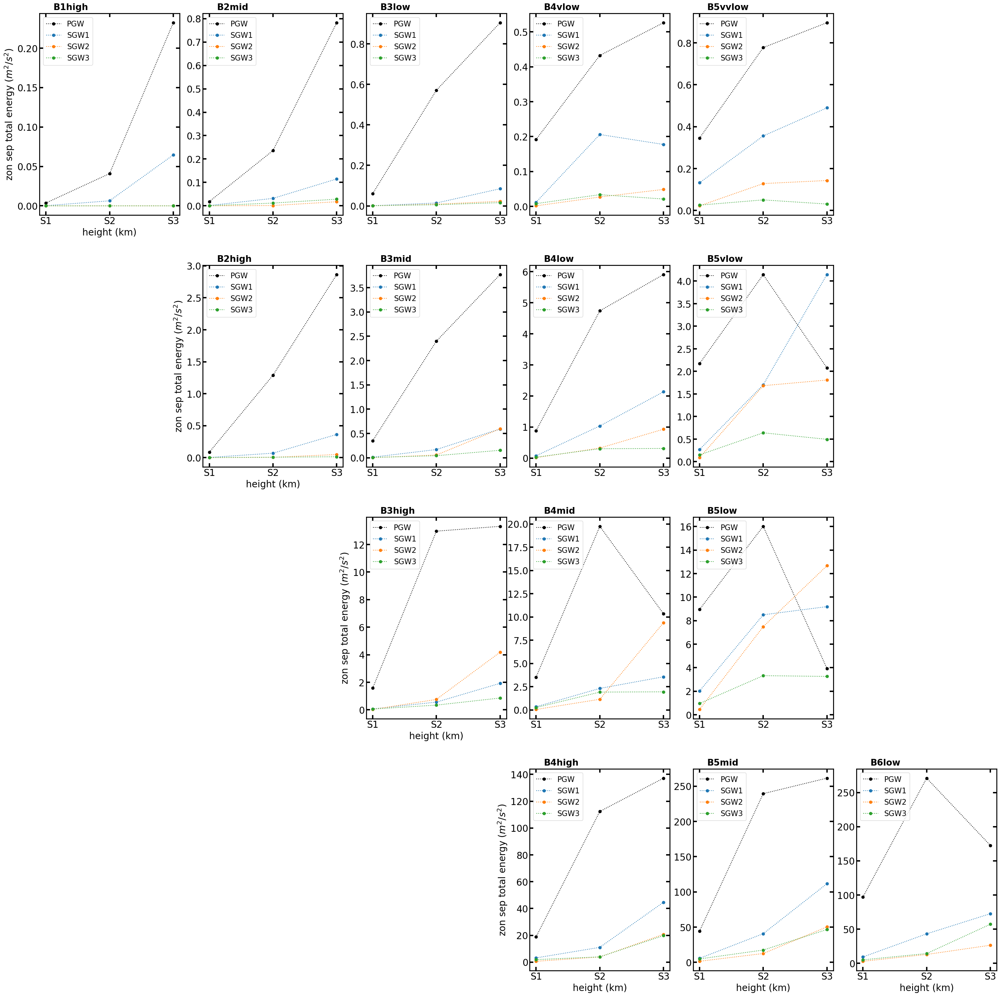

In [14]:
Table = jb.load('../supp_data/FigS12.pkl')
headers = Table.keys()

colors =['k','tab:blue', 'tab:orange', 'tab:green']
legends=['PGW', 'SGW1','SGW2','SGW3']
x_lables = ['S1', 'S2', 'S3']

fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(30, 30))
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
fig.tight_layout(pad=2.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.25)

for iname in (headers):
    
    ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
    ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)
    ###########################################################
    data = Table[iname]
    tstrength = iname[2:]
    icol = int(iname[1])-1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    ax = axes[j, i]
    ax.axis("on")  # Activate the frame

    ###########################################################
    handles, labels = [], []
    k=0
    for column in data.columns:  # Loop through each column
        line, = ax.plot(data[column], label=column, color=colors[k], marker='o', linestyle=':') 
        handles.append(line)
        labels.append(legends[k])
        k+=1
    ###########################################################
    ax.legend(handles, labels, loc='upper left',  fontsize=16)    
    
    # ax.xaxis.set_major_locator(MultipleLocator(20)) 
    ax.set_xticks([80,100,120],x_lables)
    ax.text(
        0.1, 1.03,  # Position above the plot (relative to axes)
        f"{iname}", fontsize=19, fontweight='bold',  # Font size for the entire string
        ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
    ) 

    if i == j:        
        ax.set(ylabel='zon sep total energy ($m^2/s^2$)', xlabel='height (km)')
    elif j == 3:
        ax.set(xlabel='height (km)')
        
# plt.savefig('../supp_figs/FigS12.pdf',bbox_inches='tight')

plt.show() 

<span style="font-size:40px;">Figure S13</span>

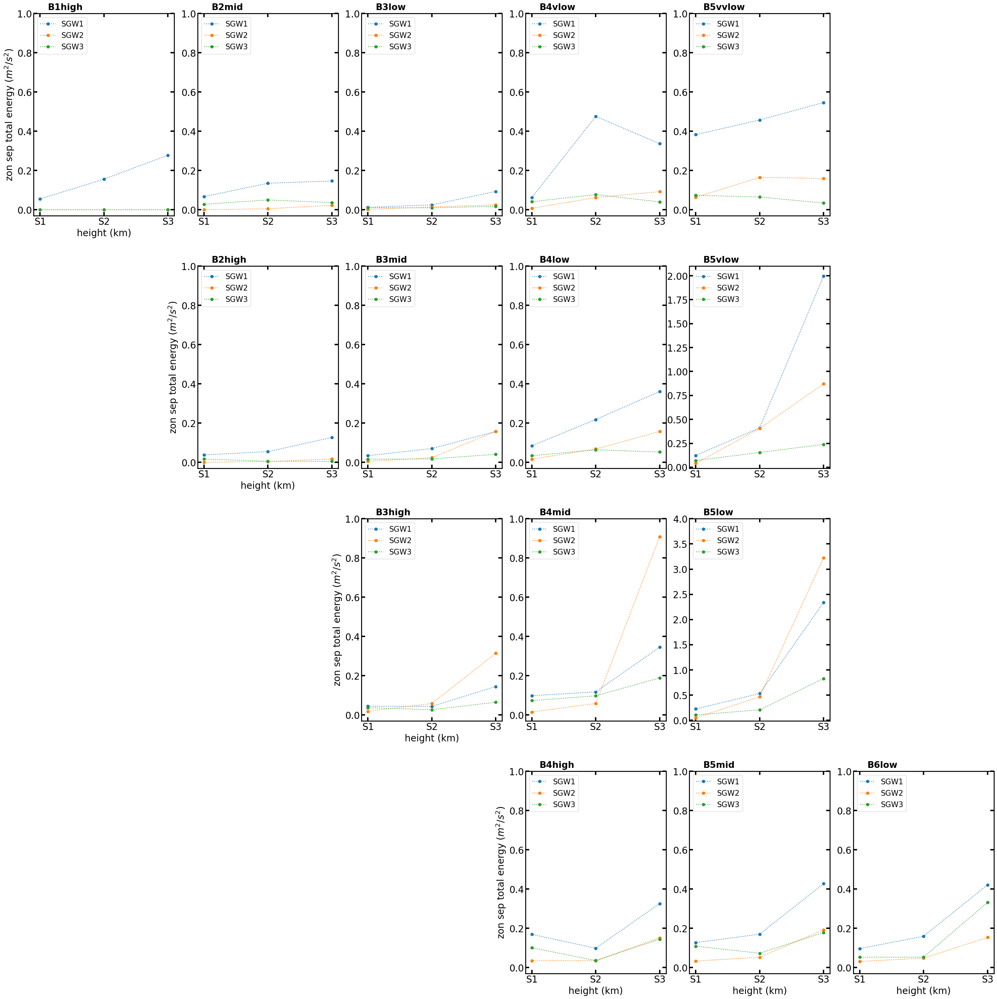

In [15]:
Table = jb.load('../supp_data/FigS13.pkl')
headers = Table.keys()

colors =['tab:blue', 'tab:orange', 'tab:green']
legends=[ 'SGW1','SGW2','SGW3']
x_lables = ['S1', 'S2', 'S3']

fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(30, 30))
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
fig.tight_layout(pad=2.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.25)

for iname in (headers):
    
    ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
    ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)
    ###########################################################
    data = Table[iname]
    tstrength = iname[2:]
    icol = int(iname[1])-1
    i = icol
    if tstrength == 'high':   j = i
    if tstrength == 'mid':    j = i - 1
    if tstrength == 'low':    j = i - 2
    if tstrength == 'vlow':   j = i - 3
    if tstrength == 'vvlow':  j = i - 4

    ax = axes[j, i]
    ax.axis("on")  # Activate the frame

    ###########################################################
    handles, labels = [], []
    k=0
    for column in data.columns:  # Loop through each column
        line, = ax.plot(data[column], label=column, color=colors[k], marker='o', linestyle=':') 
        handles.append(line)
        labels.append(legends[k])
        k+=1
    ###########################################################
    ax.legend(handles, labels, loc='upper left',  fontsize=16)    
    ax.set_ylim([-0.03,1])
    if iname== 'B5low': ax.set_ylim([-0.01,4])
    if iname== 'B5vlow': ax.set_ylim([-0.01,2.1])
    
    # ax.xaxis.set_major_locator(MultipleLocator(20)) 
    ax.set_xticks([80,100,120],x_lables)

    if i == j:        
        ax.set(ylabel='zon sep total energy ($m^2/s^2$)', xlabel='height (km)')
    elif j == 3:
        ax.set(xlabel='height (km)')
    ax.text(
        0.1, 1.03,  # Position above the plot (relative to axes)
        f"{iname}", fontsize=19, fontweight='bold',  # Font size for the entire string
        ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
    )   
# plt.savefig('../supp_figs/FigS13.pdf',bbox_inches='tight')

plt.show() 

<span style="font-size:40px;">Figure S14</span>

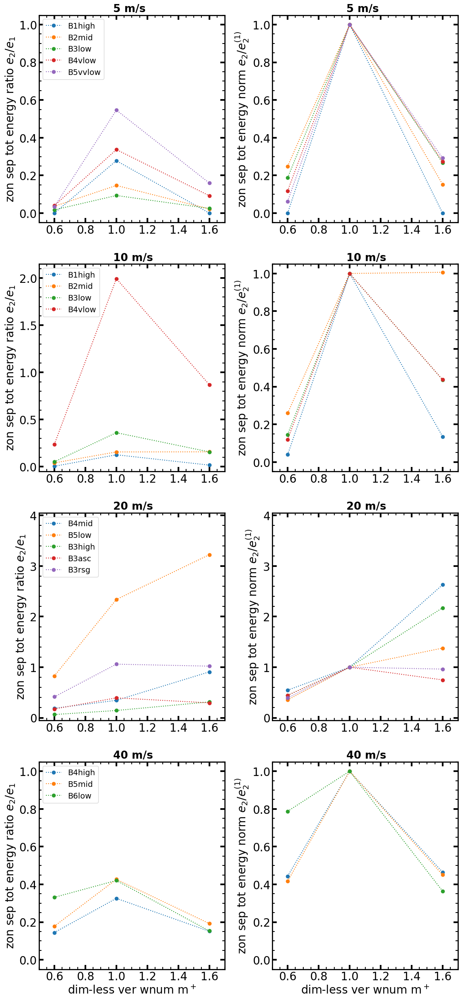

In [16]:
Table = jb.load('../supp_data/FigS14.pkl')
headers = Table.keys()
# print(headers)
labels= {'U5': ['B1high', 'B2mid', 'B3low', 'B4vlow', 'B5vvlow'],
           'U10':['B1high', 'B2mid', 'B3low', 'B4vlow', 'B5vvlow'],
           'U20':['B4mid' , 'B5low', 'B3high', 'B3asc', 'B3rsg'],
           'U40':['B4high', 'B5mid', 'B6low']}
rnv = ['rv','nv']

fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(12, 25))
fig.tight_layout(pad=1.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)

i=-1
for h in headers:
    i =i+1
    for j in [0,1]:
        ax= axes[i,j]       
        
        ###################################################################################################### plots
        df = Table[h][rnv[j]]
        handles = []
        for column in df.columns:  # Loop through each column
            line, = ax.plot(df[column], label=column, marker='o', linestyle=':')             
            handles.append(line)
                    
        ###################################################################################################### Labels and titles
        if j==0:
            ax.set(ylabel= "zon sep tot energy ratio $e_2/{e_1}$"   )   
            ax.legend(handles, labels[h], loc='upper left',  fontsize=14)  
        else:
            ax.set(ylabel=  "zon sep tot energy norm $e_2/e_2^{(1)}$" )
            
        if i==3: ax.set(xlabel='dim-less ver wnum m$^+$')
        ax.text(
            0.4, 1.03,  # Position above the plot (relative to axes)
            f"{h[1:]}"+" m/s", fontsize=19, fontweight='bold',  # Font size for the entire string
            ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
        )
        ###################################################################################################### Axis controls
        ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
        ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)
        
        ax.yaxis.set_major_locator(MultipleLocator(0.2))
        ax.yaxis.set_minor_locator(MultipleLocator(0.05))
        ax.xaxis.set_major_locator(MultipleLocator(0.2))
        ax.xaxis.set_minor_locator(MultipleLocator(0.05))
        
        ax.set(xlim=[0.5,1.7],ylim=[-0.05,1.05])        

        if i==2:
            ax.set_ylim([-0.05,4.05])
            ax.yaxis.set_major_locator(MultipleLocator(1))
            ax.yaxis.set_minor_locator(MultipleLocator(0.2))
        if i==1 and j==0: 
            ax.set_ylim([-0.05,2.15])
            ax.yaxis.set_major_locator(MultipleLocator(0.5))
            ax.yaxis.set_minor_locator(MultipleLocator(0.1))

# plt.savefig('../article_figs/FigS14.pdf',bbox_inches='tight')
plt.show()

<span style="font-size:40px;">Figure S15</span>

35.073227 19.994156
28.70459 19.984133


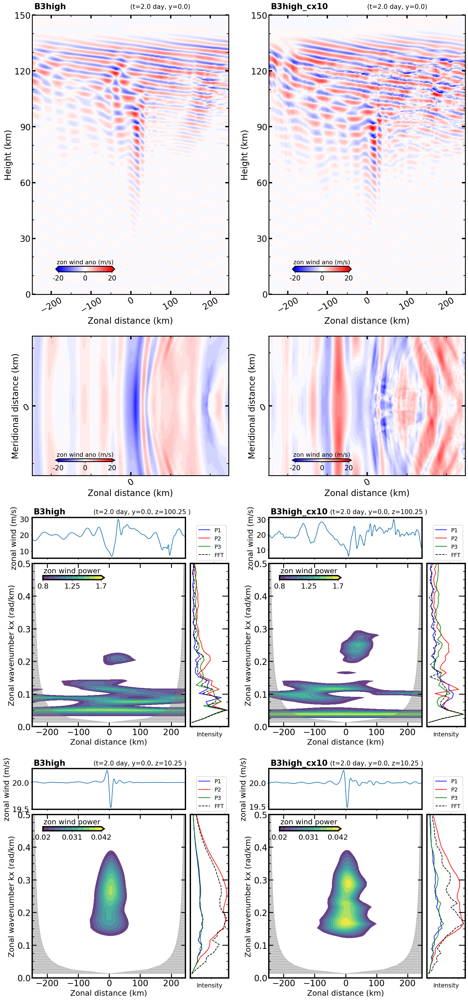

In [17]:
Table = jb.load('../supp_data/special_cases_B3high.pkl')
headers = Table.keys()
# print(headers)

iname = ['B3high', 'B3high_cx10']

fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(16, 33),
                         gridspec_kw={'height_ratios': [2, 1, 1.5, 1.5]})
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
for j in [1,0]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==0:
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    lon = data['lon'][lmin:lmax]
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    uh = data['u(t,100,lat,lon)'][:,lmin:lmax]
    
    ###################################################################################################### plots
    for i in range(4):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        if i==1: 
            print(np.max(uh),m_u[np.argmin(np.abs(height - 100))])
            lat_lon(lat, lon, time, uh, m_u, height ,fig, ax, iname[j],lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Meridional distance (km)')
        if i==2:  
            ax.axis("off")  # Activate the frame
            index100 = np.argmin(np.abs(height - 100))
            uu = u0[index100, :]
            dx = abs(lon[0] - lon[1]) * 110
        
            power, spectrum, freq = s_transfer(uu, dx)
            powerd = power[0:len(freq), :] 

            spec = gridspec.GridSpecFromSubplotSpec(
                nrows=2, ncols=2,
                subplot_spec=plt.GridSpec(4,2)[i,j],
                width_ratios=[4, 1], height_ratios=[1, 4],
                wspace=0.05, hspace=0.05
            )
            axs, axu = S6(fig, spec, lon, time, height[index100], uu, powerd, spectrum, freq, iname[j],max_l=1.7,min_l=0.8,max_y=0.5)
            axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)')
        if i==3:  
            ax.axis("off")  # Activate the frame
            index10 = np.argmin(np.abs(height - 10))
            uu = u0[index10, :]
            dx = abs(lon[0] - lon[1]) * 110
        
            power, spectrum, freq = s_transfer(uu, dx)
            powerd = power[0:len(freq), :] 

            spec = gridspec.GridSpecFromSubplotSpec(
                nrows=2, ncols=2,
                subplot_spec=plt.GridSpec(4,2)[i,j],
                width_ratios=[4, 1], height_ratios=[1, 4],
                wspace=0.05, hspace=0.05
            )
            axs, axu = S6(fig, spec, lon, time, height[index10], uu, powerd, spectrum, freq, iname[j],max_l=0.042,min_l=0.02,max_y=0.5)
            axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)')
        
    lmini = min(lon)
    lmaxi = max(lon)

# plt.savefig('../supp_figs/FigS15.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS15.png', bbox_inches='tight', dpi=70)
plt.show() 

<span style="font-size:40px;">Figure S16</span>

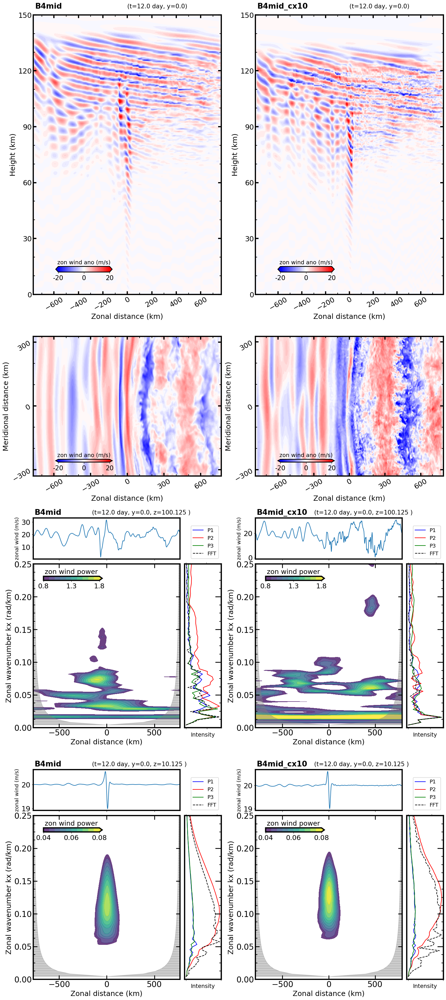

In [18]:
Table = jb.load('../supp_data/special_cases_B4mid.pkl')
headers = Table.keys()
# print(headers)

iname = ['B4mid', 'B4mid_cx10']

fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(16, 35),
                         gridspec_kw={'height_ratios': [2, 1, 1.5, 1.5]})
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
lminn = 0
lmaxx  = -1
for j in [0,1]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==1:
        lminn = np.abs(lat + 3.0).argmin()
        lmaxx = np.abs(lat - 2.975).argmin()
    
    lat = data['lat'][lminn:lmaxx]
    lon = data['lon'][lmin:lmax]
    
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    uh = data['u(t,100,lat,lon)'][lminn:lmaxx,lmin:lmax]
    ###################################################################################################### plots
    for i in range(4):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        if i==1: 
            lat_lon(lat, lon, time, uh, m_u, height ,fig, ax, iname[j],lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Meridional distance (km)')
        if i==2:  
            ax.axis("off")  # Activate the frame
            index100 = np.argmin(np.abs(height - 100))
            uu = u0[index100, :]
            dx = abs(lon[0] - lon[1]) * 110
        
            power, spectrum, freq = s_transfer(uu, dx)
            powerd = power[0:len(freq), :] 

            spec = gridspec.GridSpecFromSubplotSpec(
                nrows=2, ncols=2,
                subplot_spec=plt.GridSpec(4,2)[i,j],
                width_ratios=[4, 1], height_ratios=[1, 4],
                wspace=0.05, hspace=0.05
            )
            axs, axu = S6(fig, spec, lon, time, height[index100], uu, powerd, spectrum, freq, iname[j],max_l=1.8,min_l=0.8,max_y=0.25)
            axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)',fontsize=13)
        if i==3:  
            ax.axis("off")  # Activate the frame
            index10 = np.argmin(np.abs(height - 10))
            uu = u0[index10, :]
            dx = abs(lon[0] - lon[1]) * 110
        
            power, spectrum, freq = s_transfer(uu, dx)
            powerd = power[0:len(freq), :] 

            spec = gridspec.GridSpecFromSubplotSpec(
                nrows=2, ncols=2,
                subplot_spec=plt.GridSpec(4,2)[i,j],
                width_ratios=[4, 1], height_ratios=[1, 4],
                wspace=0.05, hspace=0.05
            )
            axs, axu = S6(fig, spec, lon, time, height[index10], uu, powerd, spectrum, freq, iname[j],min_l=0.04,max_l=0.08,max_y=0.25)
            axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)',fontsize=13)
        

# plt.savefig('../supp_figs/FigS16.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS16.png', bbox_inches='tight', dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S17</span>

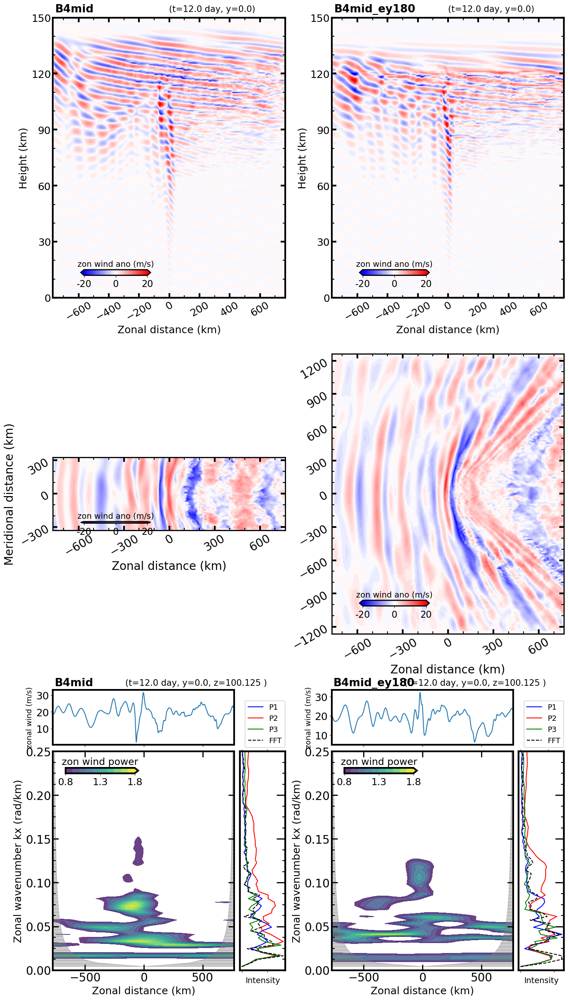

In [19]:
Table = jb.load('../supp_data/special_cases_B4mid.pkl')
headers = Table.keys()
# print(headers)

iname = ['B4mid', 'B4mid_ey180']
rows, cols = 3, 2
fig = plt.figure(figsize=(16, 30))

gs = gridspec.GridSpec(3, 2)  # Default heights
# Modify row 1 (ax[1,0]) using GridSpecFromSubplotSpec
gs_row1 = gridspec.GridSpecFromSubplotSpec(4, 1, gs[1, 0], height_ratios=[3, 1, 1, 3])  

fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
lminn = 0
lmaxx  = -1
for j in [0,1]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    
    lat = data['lat'][lminn:lmaxx]
    lon = data['lon'][lmin:lmax]
    
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    uh = data['u(t,100,lat,lon)'][lminn:lmaxx,lmin:lmax]
    ###################################################################################################### plots
    for i in range(3): 
        ax = fig.add_subplot(gs[i, j])
        if i==0:
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        if i==1: 
            if j==0:
                ax.axis("off")
                ax = fig.add_subplot(gs_row1[1:3])
                ax.set(xlabel='Zonal distance (km)', ylabel='Meridional distance (km)')
            else:
                ax.set(xlabel='Zonal distance (km)')

            lat_lon(lat, lon, time, uh, m_u, height ,fig, ax, iname[j],lim=20)
            
        if i==2:  
            ax.axis("off")  # Activate the frame
            index100 = np.argmin(np.abs(height - 100))
            uu = u0[index100, :]
            dx = abs(lon[0] - lon[1]) * 110
        
            power, spectrum, freq = s_transfer(uu, dx)
            powerd = power[0:len(freq), :] 

            spec = gridspec.GridSpecFromSubplotSpec(
                nrows=2, ncols=2,
                subplot_spec=plt.GridSpec(rows, cols)[i,j],
                width_ratios=[4, 1], height_ratios=[1, 4],
                wspace=0.05, hspace=0.05
            )
            axs, axu = S6(fig, spec, lon, time, height[index100], uu, powerd, spectrum, freq, iname[j],max_l=1.8,min_l=0.8,max_y=0.25)
            axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)',fontsize=13)
        

# plt.savefig('../supp_figs/FigS17.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS17.png', bbox_inches='tight', dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S18</span>

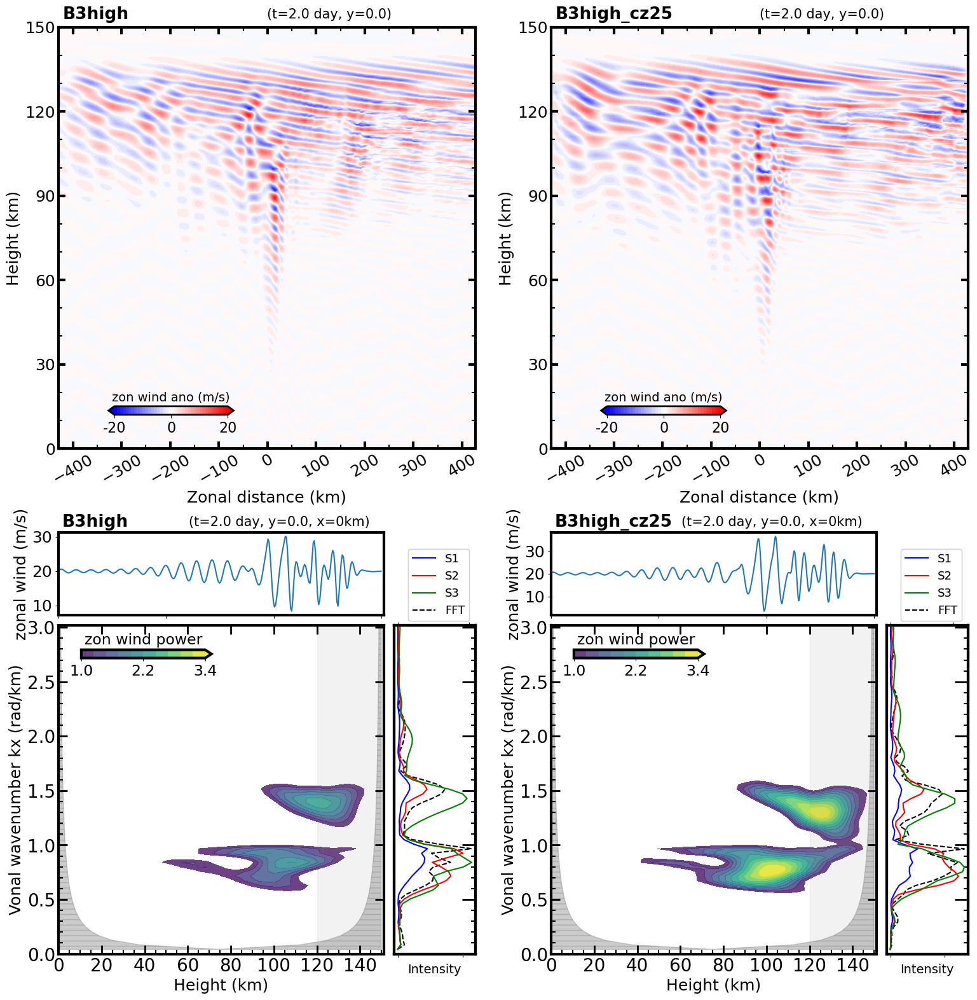

In [20]:
Table = jb.load('../supp_data/special_cases_B3high.pkl')
headers = Table.keys()
# print(headers)

iname = ['B3high', 'B3high_cz25']

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(16, 16))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
for j in [1,0]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==0:
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    lon = data['lon'][lmin:lmax]
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    uh = data['u(t,100,lat,lon)'][:,lmin:lmax]
    
    ###################################################################################################### plots
    for i in range(2):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        if i==1:  
            ax.axis("off")  # Activate the frame
            index_l = int(len(lon)/2)+1 # perpendicular to the mountain crest
            uu = u0[:, index_l]
            dz = abs(height[0] - height[1]) 
        
            power, spectrum, freq = s_transfer(uu, dz)
            powerd = power[0:len(freq), :] 

            spec = gridspec.GridSpecFromSubplotSpec(
                nrows=2, ncols=2,
                subplot_spec=plt.GridSpec(2,2)[i,j],
                width_ratios=[4, 1], height_ratios=[1, 4],
                wspace=0.05, hspace=0.05
            )
            axs, axu = S7(fig, spec,  height, time, 0, uu, powerd, spectrum, freq, iname[j],min_l=1,max_l=3.4)
            axs.set(xlabel='Height (km)', ylabel='Vonal wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)')
      
        
    lmini = min(lon)
    lmaxi = max(lon)

# plt.savefig('../supp_figs/FigS18.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS18.png', bbox_inches='tight', dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S19</span>

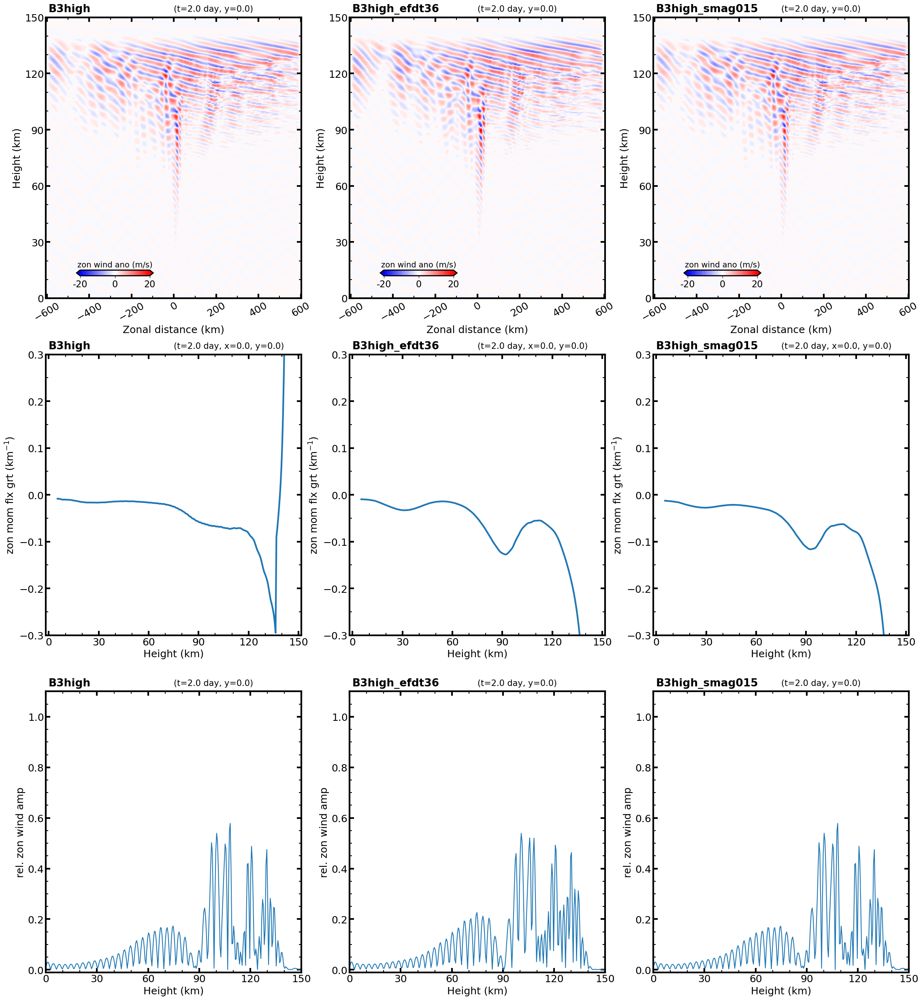

In [21]:
Table = jb.load('../supp_data/special_cases_B3high.pkl')
headers = Table.keys()

iname = ['B3high','B3high_efdt36','B3high_smag015']

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(23, 25))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
for j in [1,0,2]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==0:
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    lon = data['lon'][lmin:lmax]
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    fx = data['fx']
    lon_m = int(len(data['lon'])/2)+1   # lon=0
    u = data['u(t,z,0,lon)'][:,lon_m]
    ###################################################################################################### plots
    for i in range(3):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        else:
            if i==2:                 
                S4(lon, time, height, u, m_u, ax, iname[j])                
                ax.set(ylabel='rel. zon wind amp', xlabel='Height (km)')
            if i==1:  
                ax.plot(height,fx, linewidth=3)
                ax.set(ylim=([-0.3,0.3]))
                ax.set(ylabel='zon mom flx grt (km$^{-1}$)', xlabel='Height (km)')        
                ax.yaxis.set_major_locator(MultipleLocator(0.1)) 
                ax.yaxis.set_minor_locator(MultipleLocator(0.05))
                ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in'
                   , top=True, right=True)
                ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in'
                           , top=True, right=True)
                          
                ax.xaxis.set_major_locator(MultipleLocator(30)) 
                ax.xaxis.set_minor_locator(MultipleLocator(10)) 
                title_time = f"(t={round(time, 1)} day, x=0.0, y=0.0)"
                ax.text(
                    0.01, 1.03,  # Same position for alignment
                    iname[j], fontweight='bold',
                    fontsize=19,  # Larger font size for the main title
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
                ax.text(
                    0.5, 1.03,  # Position above the plot (relative to axes)
                    f"{title_time}", fontsize=15,  # Font size for the entire string
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
            
    lmini = min(lon)
    lmaxi = max(lon)

# plt.savefig('../supp_figs/FigS19.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS19.png',bbox_inches='tight',dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S20</span>

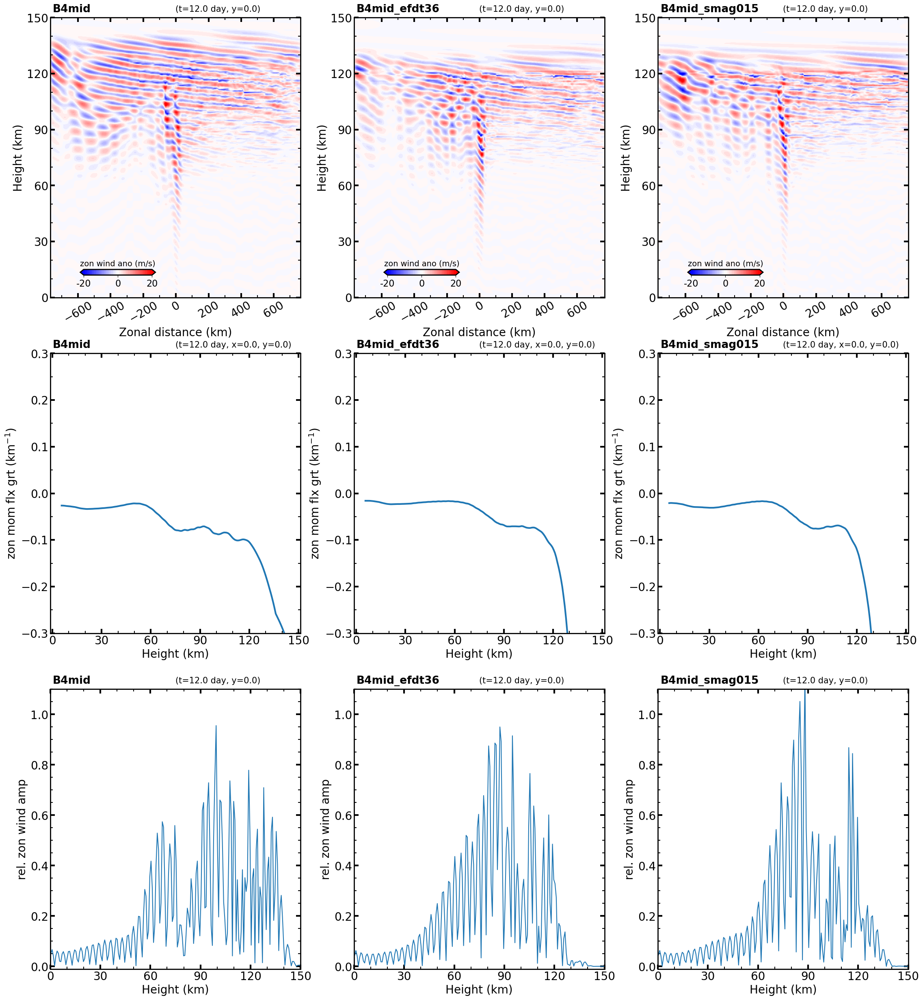

In [22]:
Table = jb.load('../supp_data/special_cases_B4mid.pkl')
headers = Table.keys()

iname = ['B4mid','B4mid_efdt36','B4mid_smag015']

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(23, 25))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
for j in [1,0,2]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==0:
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    lon = data['lon'][lmin:lmax]
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    fx = data['fx']
    lon_m = int(len(data['lon'])/2)+1   # lon=0
    u = data['u(t,z,0,lon)'][:,lon_m]
    ###################################################################################################### plots
    for i in range(3):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        else:
            if i==2:                 
                S4(lon, time, height, u, m_u, ax, iname[j])                
                ax.set(ylabel='rel. zon wind amp', xlabel='Height (km)')
            if i==1:  
                ax.plot(height,fx, linewidth=3)
                ax.set(ylim=([-0.3,0.3]))
                ax.set(ylabel='zon mom flx grt (km$^{-1}$)', xlabel='Height (km)')        
                ax.yaxis.set_major_locator(MultipleLocator(0.1)) 
                ax.yaxis.set_minor_locator(MultipleLocator(0.05))
                ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in'
                   , top=True, right=True)
                ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in'
                           , top=True, right=True)
                          
                ax.xaxis.set_major_locator(MultipleLocator(30)) 
                ax.xaxis.set_minor_locator(MultipleLocator(10)) 
                title_time = f"(t={round(time, 1)} day, x=0.0, y=0.0)"
                ax.text(
                    0.01, 1.03,  # Same position for alignment
                    iname[j], fontweight='bold',
                    fontsize=19,  # Larger font size for the main title
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
                ax.text(
                    0.5, 1.03,  # Position above the plot (relative to axes)
                    f"{title_time}", fontsize=15,  # Font size for the entire string
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
            
    lmini = min(lon)
    lmaxi = max(lon)

# plt.savefig('../supp_figs/FigS20.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS20.png',bbox_inches='tight',dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S21</span>

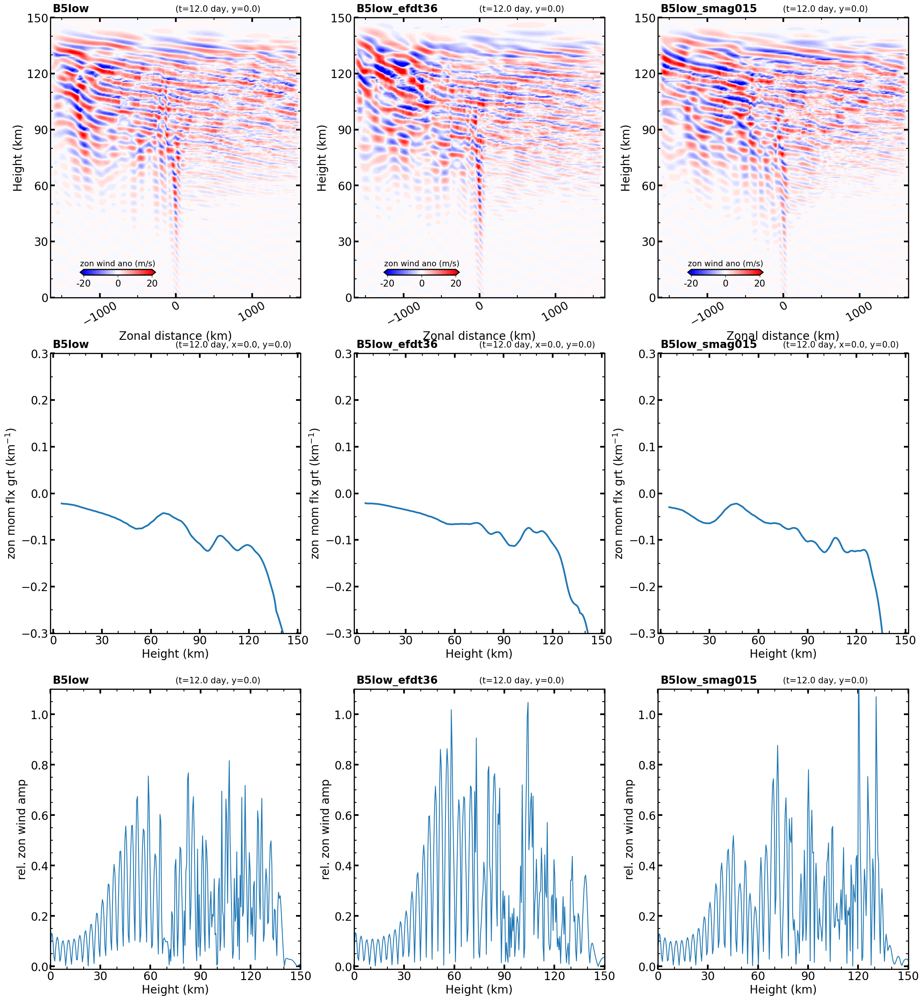

In [23]:
Table = jb.load('../supp_data/special_cases_B5low.pkl')
headers = Table.keys()

iname = ['B5low','B5low_efdt36','B5low_smag015']

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(23, 25))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
for j in [1,0,2]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==0:
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    lon = data['lon'][lmin:lmax]
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    fx = data['fx']
    lon_m = int(len(data['lon'])/2)+1   # lon=0
    u = data['u(t,z,0,lon)'][:,lon_m]
    ###################################################################################################### plots
    for i in range(3):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        else:
            if i==2:                 
                S4(lon, time, height, u, m_u, ax, iname[j])                
                ax.set(ylabel='rel. zon wind amp', xlabel='Height (km)')
            if i==1:  
                ax.plot(height,fx, linewidth=3)
                ax.set(ylim=([-0.3,0.3]))
                ax.set(ylabel='zon mom flx grt (km$^{-1}$)', xlabel='Height (km)')        
                ax.yaxis.set_major_locator(MultipleLocator(0.1)) 
                ax.yaxis.set_minor_locator(MultipleLocator(0.05))
                ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in'
                   , top=True, right=True)
                ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in'
                           , top=True, right=True)
                          
                ax.xaxis.set_major_locator(MultipleLocator(30)) 
                ax.xaxis.set_minor_locator(MultipleLocator(10)) 
                title_time = f"(t={round(time, 1)} day, x=0.0, y=0.0)"
                ax.text(
                    0.01, 1.03,  # Same position for alignment
                    iname[j], fontweight='bold',
                    fontsize=19,  # Larger font size for the main title
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
                ax.text(
                    0.5, 1.03,  # Position above the plot (relative to axes)
                    f"{title_time}", fontsize=15,  # Font size for the entire string
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
            
    lmini = min(lon)
    lmaxi = max(lon)

# plt.savefig('../supp_figs/FigS21.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS21.png',bbox_inches='tight',dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S22</span>

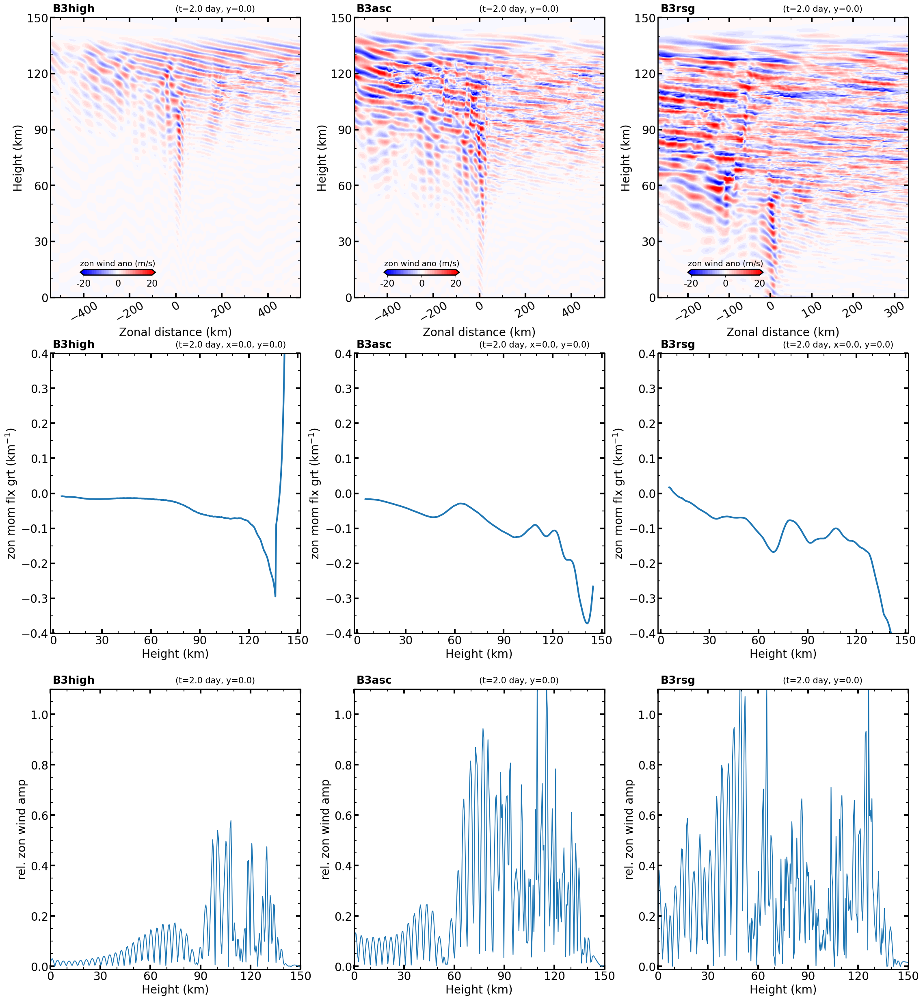

In [24]:
Table = jb.load('../supp_data/special_cases_B3high.pkl')
headers = Table.keys()

iname = ['B3high','B3asc', 'B3rsg']

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(23, 25))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
lmin = 0
lmax = -1
for j in [1,0,2]: 
    ###################################################################################################### data
    data = Table[iname[j]]
    lat = data['lat']
    lon = data['lon']
    if j==0:
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    lon = data['lon'][lmin:lmax]
    time = data['time']
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    m_u = data['m_u(t,z)']
    fx = data['fx']
    lon_m = int(len(data['lon'])/2)+1   # lon=0
    u = data['u(t,z,0,lon)'][:,lon_m]
    ###################################################################################################### plots
    for i in range(3):
        ax= axes[i,j] 
        if i==0: 
            S2(lon, time, height, u0, m_u, fig, ax, iname[j], lim=20)
            ax.set(xlabel='Zonal distance (km)', ylabel='Height (km)')
        else:
            if i==2:                 
                S4(lon, time, height, u, m_u, ax, iname[j])                
                ax.set(ylabel='rel. zon wind amp', xlabel='Height (km)')
            if i==1:  
                ax.plot(height,fx, linewidth=3)
                ax.set(ylim=([-0.4,0.4]))
                ax.set(ylabel='zon mom flx grt (km$^{-1}$)', xlabel='Height (km)')        
                ax.yaxis.set_major_locator(MultipleLocator(0.1)) 
                ax.yaxis.set_minor_locator(MultipleLocator(0.05))
                ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in'
                   , top=True, right=True)
                ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in'
                           , top=True, right=True)
                          
                ax.xaxis.set_major_locator(MultipleLocator(30)) 
                ax.xaxis.set_minor_locator(MultipleLocator(10)) 
                title_time = f"(t={round(time, 1)} day, x=0.0, y=0.0)"
                ax.text(
                    0.01, 1.03,  # Same position for alignment
                    iname[j], fontweight='bold',
                    fontsize=19,  # Larger font size for the main title
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
                ax.text(
                    0.5, 1.03,  # Position above the plot (relative to axes)
                    f"{title_time}", fontsize=15,  # Font size for the entire string
                    ha='left', va='center', transform=ax.transAxes  # Use relative coordinates
                )
            
    lmini = min(lon)
    lmaxi = max(lon)

# plt.savefig('../supp_figs/FigS22.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS22.png',bbox_inches='tight',dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S23</span>

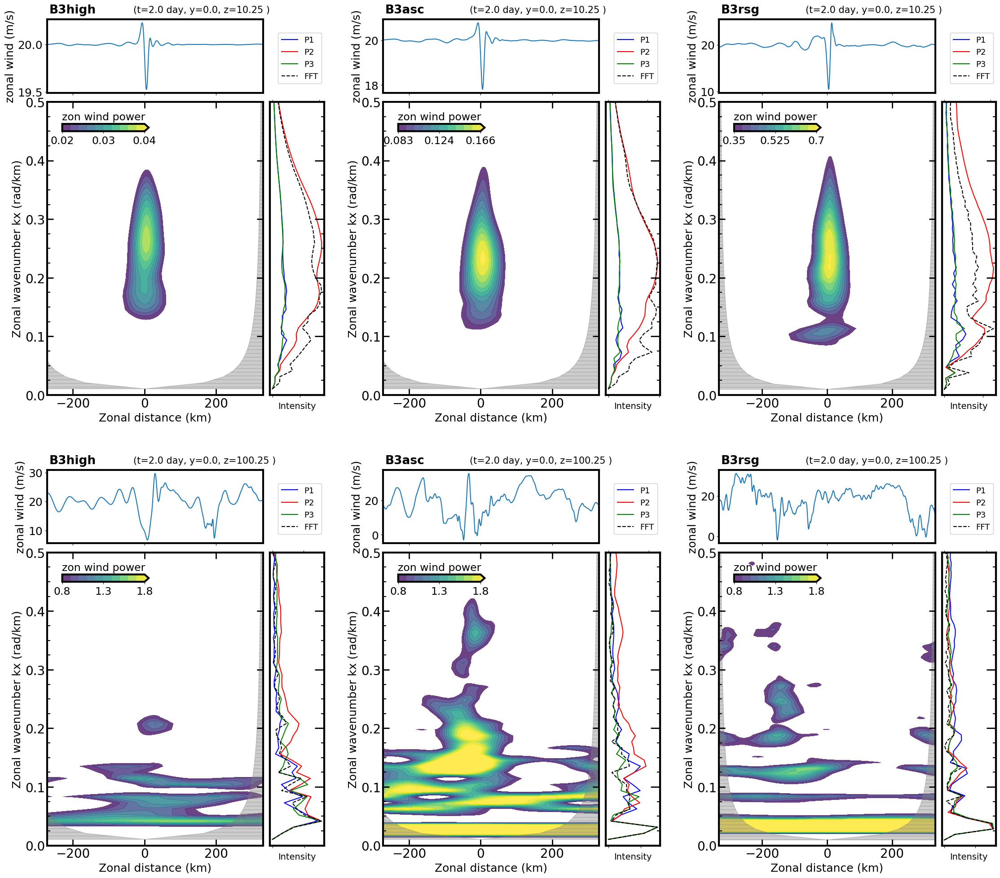

In [25]:
Table = jb.load('../supp_data/special_cases_B3high.pkl')
headers = Table.keys()

iname = ['B3high','B3asc', 'B3rsg']

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(23, 20))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)
for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
for i in [2,1,0]:  #number of columns
        ###################################################################################################### data
    data = Table[iname[i]]
    lat = data['lat']
    lon = data['lon']
    # print(lmin,lmax)
    if i==2:
        lmin = 0
        lmax = len(lon)
    else:        
        lmin = np.abs(lon - lmini).argmin()
        lmax = np.abs(lon - lmaxi).argmin()
    # print(i,len(lon),lmin,lmax)    
    # print(i,lon[lmin],lon[lmax-1])
    lon = data['lon'][lmin:lmax]
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,lmin:lmax]
    ###################################################################################################### plots
    min_l = 0.35 if i == 2 else np.round(min_l / (4.2  *10**(j-1 )),3) # adjusting the limits of colorbar!
    for j in range(2):
        if j==0: min_l2 = min_l ; max_l=min_l2*2
        if j==1: min_l2 = 0.8   ; max_l= 1.8
        # print(j,40**j,min_l2)
        ax= axes[j,i] 
        hh=10*10**j# 10*1 or 10*10 ;-)
        index = np.argmin(np.abs(height - hh)) 
        uu = u0[index, :]
        dx = abs(lon[0] - lon[1]) * 110
    
        power, spectrum, freq = s_transfer(uu, dx)
        powerd = power[0:len(freq), :] 

        spec = gridspec.GridSpecFromSubplotSpec(
            nrows=2, ncols=2,
            subplot_spec=plt.GridSpec(2,3)[j,i],
            width_ratios=[4, 1], height_ratios=[1, 4],
            wspace=0.05, hspace=0.05
        )
        
        axs, axu = S6(fig, spec, lon, time, height[index], uu, powerd, spectrum, freq, iname[i],min_l=min_l2,max_l=max_l,max_y=0.5)#
        
        axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
        axu.set_ylabel('zonal wind (m/s)')
        
# plt.savefig('../supp_figs/FigS23.pdf',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS23.png',bbox_inches='tight',dpi=70)

plt.show() 

<span style="font-size:40px;">Figure S24</span>

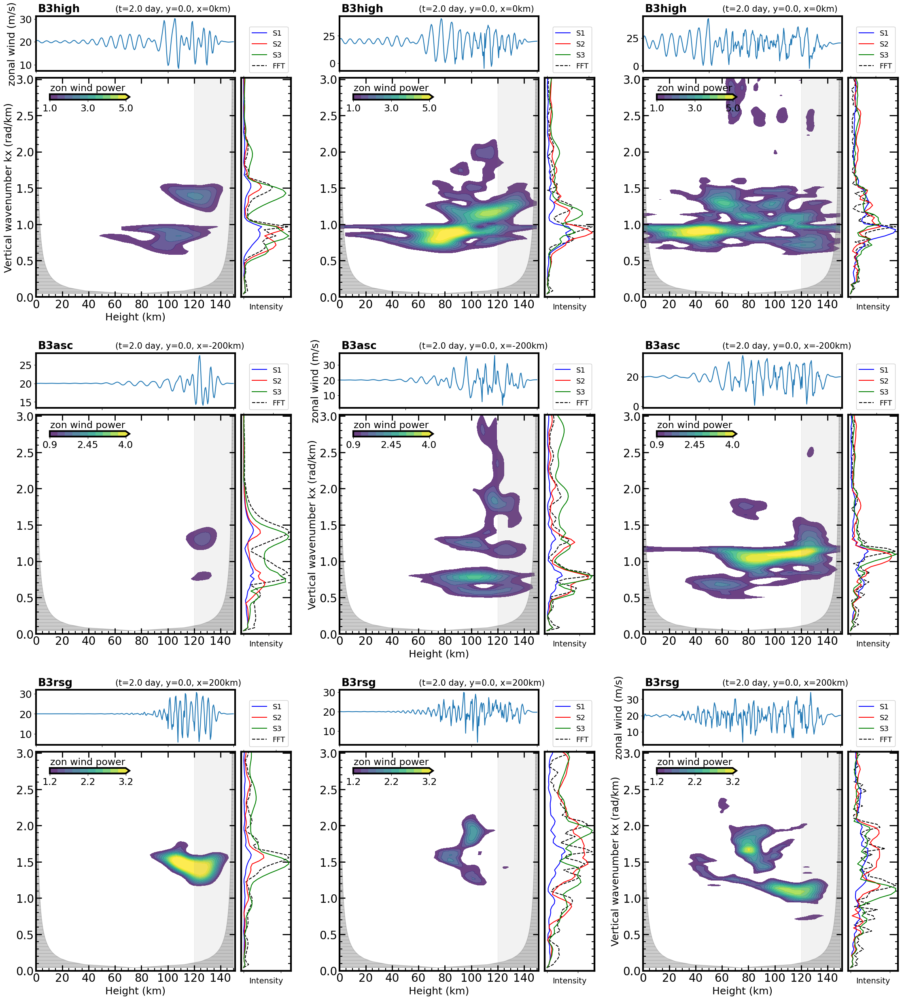

In [26]:
Table = jb.load('../supp_data/special_cases_B3high.pkl')
headers = Table.keys()

iname = ['B3high','B3asc', 'B3rsg']

rows, cols = 3, 3
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(23, 25))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)

for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
    
for i in [2,1,0]:  #number of columns
        ###################################################################################################### data
    data = Table[iname[i]]
    lat = data['lat']
    lon = data['lon']
    # print(lmin,lmax)
    mid_lon = int(len(lon)/2)
    height = data['height'][:,1]
    u0 = data['u(t,z,0,lon)'][:,:]    
    dz = abs(height[0] - height[1])
    dx = abs(lon[0] - lon[1]) * 110
    ###################################################################################################### plots
    for j in range(3):
        ax= axes[j,i]
        if j==0  : #central position index
            index_l = mid_lon 
            min_l, max_l = 1, 5
        elif j==1: # upwind index
            index_l = mid_lon-int (200/dx)-1 
            min_l, max_l = 0.9, 4
        else     : # downwind index
            index_l = mid_lon+int (200/dx)+1 
            min_l, max_l = 1.2, 3.2
        
        uu = u0[:, index_l]
        power, spectrum, freq = s_transfer(uu, dz)
        powerd = power[0:len(freq), :] 
        spec = gridspec.GridSpecFromSubplotSpec(
            nrows=2, ncols=2,
            subplot_spec=plt.GridSpec(rows, cols)[j, i],
            width_ratios=[4, 1], height_ratios=[1, 4],
            wspace=0.05, hspace=0.05
        )
        x = int(lon[index_l]*110)# zonal distance (km)
        axs, axu = S7(fig, spec, height, time, x, uu, powerd, spectrum, freq, iname[j],min_l=min_l,max_l=max_l)
    
        if i == j:        
            axs.set(xlabel='Height (km)', ylabel='Vertical wavenumber kx (rad/km)')
            axu.set_ylabel('zonal wind (m/s)')
        elif j == 2:
            axs.set(xlabel='Height (km)')
            
# plt.savefig('../supp_figs/FigS24.png',bbox_inches='tight',dpi=70)
# plt.savefig('../supp_figs/FigS24.pdf',bbox_inches='tight')
plt.show()


<span style="font-size:40px;">Figure S25</span>

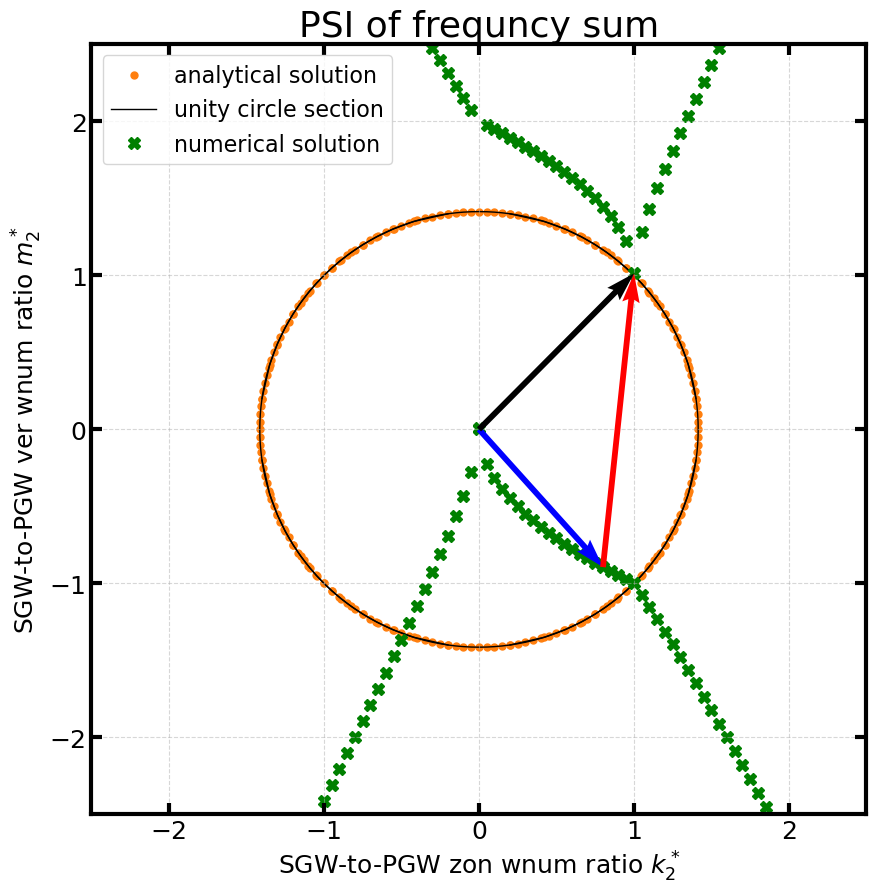

In [27]:
Table = jb.load('../supp_data/FigS25.pkl')
headers = Table.keys()

fig, ax = plt.subplots(figsize=(10, 10))

ax.grid(True, linestyle="--", alpha=0.5)
ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in', top=True, right=True)
ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in', top=True, right=True)

ax.set(xlim=[-2.5,2.5],ylim=[-2.5,2.5])

#################################################################################################    
handles, labels = [], []
for h in headers:
    # print(h)
    if h != 'numerical solution':
        if h == 'unity circle section':
            # Black thin line
            linestyle = '-'  ;color = 'black'; linewidth = 1; marker = None; label= h  # No marker
        else:
            # Orange dots
            linestyle = 'None'; color = 'tab:orange'; linewidth = 0 ; marker = 'o'; markersize = 5; label= h
        for i in range(1,5):
            data = Table[h][i]
            line, =ax.plot(data['k'],data['m'],marker=marker, markersize=markersize, linewidth=linewidth, color=color, 
                           linestyle=linestyle, label= h, zorder=1)
            if i==2:
                handles.append(line)
                labels.append(h)
    else:
        data = Table[h]
        line, = ax.plot(data['k'],data['m'],marker='X',linewidth = 0, markersize=9, color='green', label= h, zorder=1)
        handles.append(line)
        labels.append(h)
ax.legend(handles, labels, loc='upper left',  fontsize=16) 
#################################################################################################        
# Arrows


# Define vectors using start and end points: (x_start, y_start, x_end, y_end)
vectors = np.array([
    [data.at[26,'k'], data.at[26,'m'], data.at[58,'k'], data.at[58,'m']],  # First vector (blue)
    [ data.at[58,'k'], data.at[58,'m'],  data.at[67,'k'], data.at[67,'m']], # Second vector (red)
])

# Compute dx, dy (end - start)
dx = vectors[:, 2] - vectors[:, 0]
dy = vectors[:, 3] - vectors[:, 1]

# Compute resultant vector (from first start to last end)
result_vector = np.array([vectors[0, 0], vectors[0, 1], vectors[-1, 2] - vectors[0, 0], vectors[-1, 3] - vectors[0, 1]]) # resultant vector in black

ax.quiver(vectors[:, 0], vectors[:, 1], dx, dy, angles='xy', scale_units='xy', scale=1, color=['blue', 'red'], zorder=2)
ax.quiver(result_vector[0], result_vector[1], result_vector[2], result_vector[3], angles='xy', scale_units='xy', scale=1, color='k', zorder=3)

ax.set_title('PSI of frequncy sum', fontsize=26)
ax.set(ylabel='SGW-to-PGW ver wnum ratio $m^*_2$', xlabel='SGW-to-PGW zon wnum ratio $k^*_2$')

# plt.savefig('../supp_figs/FigS25.pdf',bbox_inches='tight')

plt.show() 

<span style="font-size:40px;">Figure S27</span>

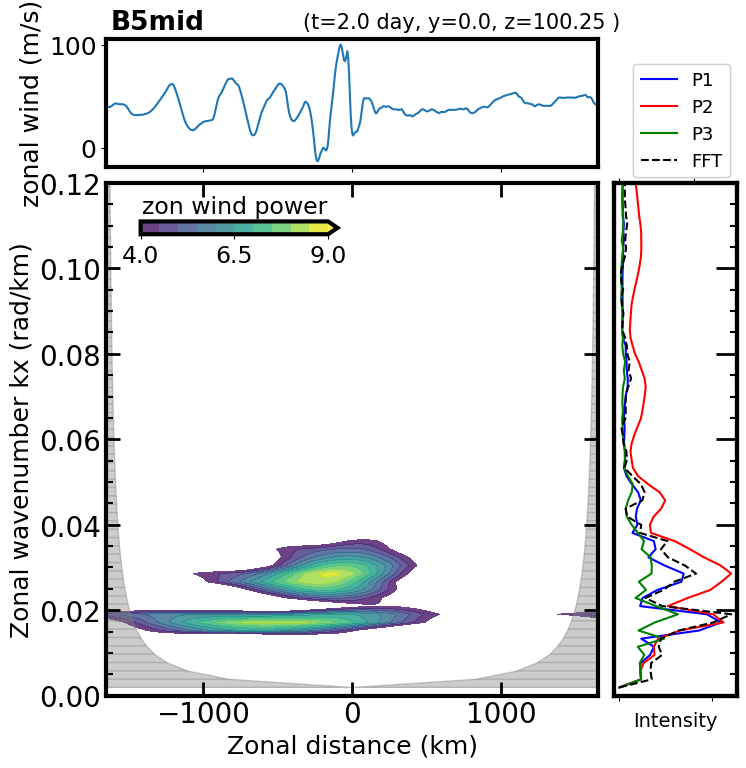

In [28]:
all_data = jb.load('../supp_data/selected_simulations_time_short.pkl')

iname = 'B5mid'

rows, cols = 1, 1
fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(8, 8))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)

ax.axis("off")
        ###################################################################################################### data
data = all_data[iname]
lat = data['lat']
lon = data['lon']
# print(lmin,lmax)
index100 = np.argmin(np.abs(height - 100.0))
height = data['height'][:,1]
u0 = data['u(t,z,0,lon)'][:,:]    
dz = abs(height[0] - height[1])
dx = abs(lon[0] - lon[1]) * 110
    ###################################################################################################### plots

uu = u0[index100, :]
power, spectrum, freq = s_transfer(uu, dx)
powerd = power[0:len(freq), :] 
spec = gridspec.GridSpecFromSubplotSpec(
    nrows=2, ncols=2,
    subplot_spec=plt.GridSpec(rows, cols)[0,0],
    width_ratios=[4, 1], height_ratios=[1, 4],
    wspace=0.05, hspace=0.05
)
axs, axu = S6(fig, spec, lon, time, height[index100], uu, powerd, spectrum, freq, iname,min_l=4,max_l=9,max_y=0.12)

axs.set(xlabel='Zonal distance (km)', ylabel='Zonal wavenumber kx (rad/km)')
axu.set_ylabel('zonal wind (m/s)')

# plt.savefig('../supp_figs/FigS26.pdf',bbox_inches='tight')
plt.show() 


<span style="font-size:40px;">Figure S27</span>

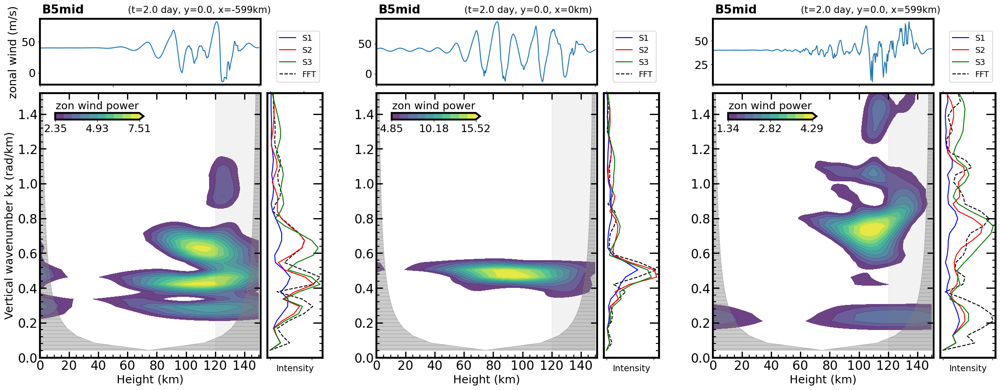

In [29]:
all_data = jb.load('../supp_data/selected_simulations_time_short.pkl')
headers = all_data.keys()

iname = 'B5mid'

rows, cols = 1, 3
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(23, 9))
fig.tight_layout(pad=2)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.2)

for ax in axes.flatten(): # deactivate all subplots' frame
    ax.axis("off")
    

        ###################################################################################################### data
data = all_data[iname]
lat = data['lat']
lon = data['lon']
# print(lmin,lmax)
mid_lon = int(len(lon)/2)
height = data['height'][:,1]
u0 = data['u(t,z,0,lon)'][:,:]    
dz = abs(height[0] - height[1])
dx = abs(lon[0] - lon[1]) * 110

    ###################################################################################################### plots
for j in range(3):
    ax= axes[j]
    if j==1  : #central position index
        index_l = mid_lon 
        min_l, max_l = 1, 5
    elif j==0: # upwind index
        index_l = mid_lon-int (599/dx)-1 
        min_l, max_l = 0.9, 4
    else     : # downwind index
        index_l = mid_lon+int (599/dx)+1 
        min_l, max_l = 1, 3
    
    uu = u0[:, index_l]
    power, spectrum, freq = s_transfer(uu, dz)
    powerd = power[0:len(freq), :] 
    spec = gridspec.GridSpecFromSubplotSpec(
        nrows=2, ncols=2,
        subplot_spec=plt.GridSpec(rows, cols)[0,j],
        width_ratios=[4, 1], height_ratios=[1, 4],
        wspace=0.05, hspace=0.05
    )
    x = int(lon[index_l]*110)# zonal distance (km)
    axs, axu = S7(fig, spec, height, time, x, uu, powerd, spectrum, freq, iname)#,min_l=min_l,max_l=max_l)

    if j == 0:        
        axs.set(ylabel='Vertical wavenumber kx (rad/km)')
        axu.set_ylabel('zonal wind (m/s)')
    axs.set(xlabel='Height (km)')
# plt.savefig('../supp_figs/FigS27.png',bbox_inches='tight',dpi=70)
# plt.savefig('../supp_figs/FigS27.pdf',bbox_inches='tight')
plt.show()


<span style="font-size:40px;">Figure S28</span>

C:\Users\Mozhgan\AppData\Local\Temp\ipykernel_2132\1070146787.py:25: RuntimeWarning: invalid value encountered in sqrt
  x_b = np.sqrt(4 * (data['z'] - 0.35))


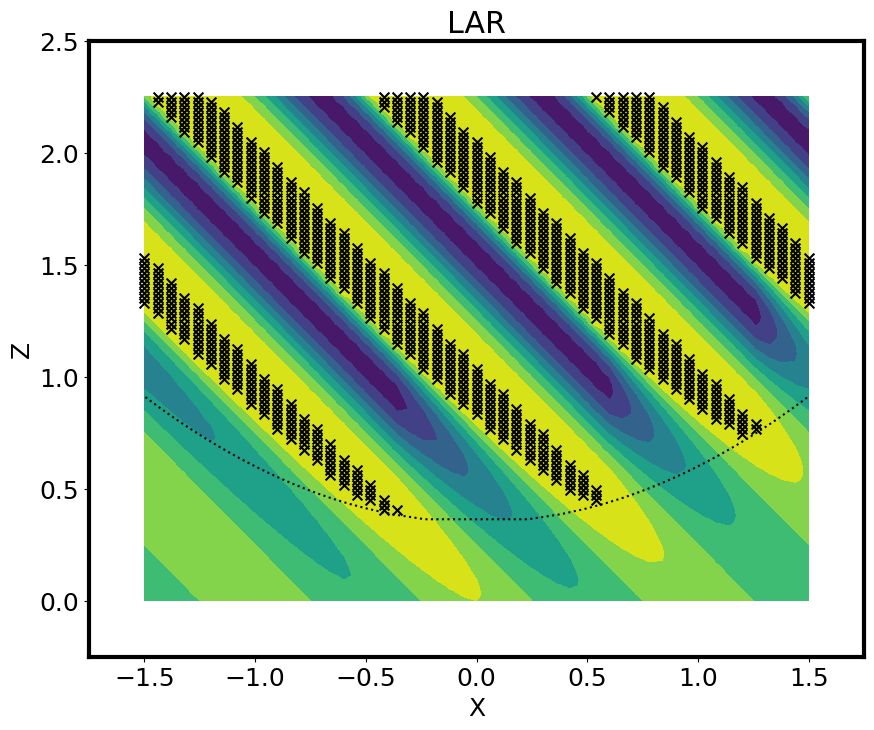

In [30]:
data = jb.load('../supp_data/S28.pkl')


fig, ax = plt.subplots( figsize=(10, 8))
########## shaded part
ax.contourf(data['x'],data['z'],data['u2'])
########## 'x' line
X, Z = np.meshgrid(data['x'], data['z'])  # Use real coordinates
# Mask condition
mask = data['u2'] >= 1
# Extract values where mask is True
x_vals = X[mask]  # Extract real x positions
z_vals = Z[mask]  # Extract real z positions

# Plot scatter points with 'x' where u' ~ U0
ax.scatter(x_vals, z_vals, marker='x', color='k', label=r"values of $u' \approx U_0$", s=50)
ax.set(xlabel='X', ylabel='Z',title='LAR')
# ax.legend()
########### dotted line
data = {
    'z': np.linspace(0, 2.25, 100),  # Simulated z values
    'x': np.linspace(-1.5, 1.5, 100)  # Simulated x values
}
# Compute x_b ensuring size matches with data['z']
x_b = np.sqrt(4 * (data['z'] - 0.35))

# Ensure x_b stays within range 0 to 1.5
mask = (x_b <= 1.5) & (x_b >= 0)  # Valid values only
x_b = x_b[mask]
z_valid = data['z'][mask]  # Match 'z' values

# Create a symmetric x array for scatter plot
x = np.concatenate((-x_b[::-1], x_b))

z_valid = np.concatenate((z_valid[::-1], z_valid))  # Make z match
ax.plot(x,z_valid, ':',  color='k')

ax.set(xlim=[-1.75,1.75],ylim=[-0.25,2.5])
# plt.savefig('../supp_figs/FigS28.png',bbox_inches='tight')
# plt.savefig('../supp_figs/FigS28.pdf',bbox_inches='tight')
plt.show()

<span style="font-size:40px;">Figure S29</span>

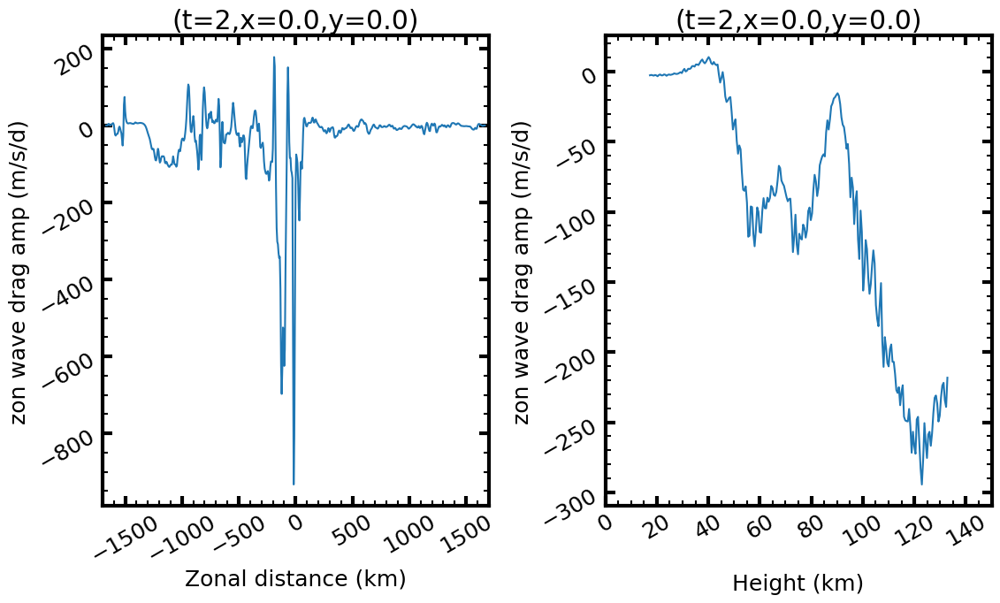

In [31]:
data = jb.load('../supp_data/S29.pkl')


fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 7))
fig.tight_layout(pad=2.5)  # Reduce overall padding 
fig.subplots_adjust(hspace=0.25)
######## some general Axes setups
for ax in axes:    
    ax.tick_params(axis='both', which='major',  length=8, width=3, direction ='in'
                   , top=True, right=True)
    ax.tick_params(axis='both', which='minor',  length=4, width=1.5, direction ='in'
               , top=True, right=True)
    
    for label in ax.get_yticklabels():
        label.set_rotation(30)
    for label in ax.get_xticklabels():
        label.set_rotation(30)
######## zonal wave drag --> zonal section
ax = axes[1]
ax.plot(data['flxz']['x'], data['flxz']['y'])  
ax.xaxis.set_major_locator(MultipleLocator(20))    
ax.xaxis.set_minor_locator(MultipleLocator(5))
ax.yaxis.set_major_locator(MultipleLocator(50))    
ax.yaxis.set_minor_locator(MultipleLocator(10))
ax.set(xlim=[0,150])
ax.set_xlabel('Height (km)', labelpad=19) 
ax.set( ylabel='zon wave drag amp (m/s/d)',title='(t=2,x=0.0,y=0.0)')
    #################
ax = axes[0]
ax.plot(data['flxx']['x'], data['flxx']['y'])
ax.xaxis.set_major_locator(MultipleLocator(500))    
ax.xaxis.set_minor_locator(MultipleLocator(100))
ax.yaxis.set_major_locator(MultipleLocator(200))    
ax.yaxis.set_minor_locator(MultipleLocator(50))
ax.set(xlim=[-1700,1700])
ax.set_xlabel('Zonal distance (km)', labelpad=2) 
ax.set(ylabel='zon wave drag amp (m/s/d)',title='(t=2,x=0.0,y=0.0)')

# plt.savefig('../supp_figs/FigS29.pdf',bbox_inches='tight')
plt.show()